In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Cell 1: Import necessary libraries
import numpy as np
import pandas as pd
import os
import cv2
import matplotlib.pyplot as plt
from collections import Counter
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras import layers, Model
from tensorflow.keras.utils import plot_model

print("Libraries imported successfully!")

Libraries imported successfully!


In [ ]:
# Cell 3: Get all image filenames
image_filenames = [os.path.splitext(filename)[0] for filename in os.listdir(data_dir) if filename.endswith('.jpeg')]
print(f"Found {len(image_filenames)} images")
print("First 10 image filenames:")
for i, name in enumerate(image_filenames[:10]):
    print(f"{i+1}. {name}")

In [ ]:
# Cell 4: Check label files structure
print("Checking label file structure (first 5 files):")
for image_filename in image_filenames[:5]:
    label_path = os.path.join(data_dir, image_filename + '.txt')
    if os.path.exists(label_path):
        with open(label_path, 'r') as file:
            lines = file.readlines()
            print(f"\n{image_filename}.txt: {len(lines)} annotations")
            for i, line in enumerate(lines[:2]):  # Show first 2 annotations
                print(f"  Annotation {i+1}: {line.strip()}")
    else:
        print(f"Label file not found: {label_path}")

In [ ]:
# Cell 5: Function to visualize images with bounding boxes
def visualize_sample_images(num_samples=5):
    fig, axes = plt.subplots(1, num_samples, figsize=(20, 4))
    if num_samples == 1:
        axes = [axes]

    for i, image_filename in enumerate(image_filenames[:num_samples]):
        # Read image
        image_path = os.path.join(data_dir, image_filename + '.jpeg')
        image = cv2.imread(image_path)
        if image is None:
            print(f"Could not load image: {image_path}")
            continue

        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        original_image = image.copy()

        # Read annotations
        label_path = os.path.join(data_dir, image_filename + '.txt')
        if os.path.exists(label_path):
            with open(label_path, 'r') as file:
                lines = file.readlines()
                for line in lines:
                    data = line.strip().split()
                    if len(data) != 5:
                        continue

                    class_index = int(data[0])
                    x_center = float(data[1])
                    y_center = float(data[2])
                    width = float(data[3])
                    height = float(data[4])

                    # Convert YOLO format to bounding box coordinates
                    img_height, img_width = image.shape[:2]
                    x_min = int((x_center - width/2) * img_width)
                    y_min = int((y_center - height/2) * img_height)
                    x_max = int((x_center + width/2) * img_width)
                    y_max = int((y_center + height/2) * img_height)

                    # Draw bounding box
                    color = (0, 255, 0) if class_index == 0 else (255, 0, 0)  # Green for crop, Red for weed
                    cv2.rectangle(image, (x_min, y_min), (x_max, y_max), color, 2)

                    # Add class label
                    class_label = class_names[class_index]
                    cv2.putText(image, class_label, (x_min, max(y_min-10, 10)),
                               cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

        axes[i].imshow(image)
        axes[i].set_title(f'{image_filename}\n{len(lines) if os.path.exists(label_path) else 0} objects')
        axes[i].axis('off')

    plt.tight_layout()
    plt.show()

# Visualize samples
visualize_sample_images(5)

In [ ]:
# Cell 6: Load and preprocess data correctly
def load_data(data_dir, image_filenames, target_size=(224, 224), max_objects=10):
    X, y_bbox, y_class = [], [], []

    for filename in image_filenames:
        # Load and resize image
        image_path = os.path.join(data_dir, filename + '.jpeg')
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image_resized = cv2.resize(image, target_size)
        X.append(image_resized)

        # Load annotations
        label_path = os.path.join(data_dir, filename + '.txt')
        bboxes, class_labels = [], []

        with open(label_path, 'r') as file:
            for line in file.readlines():
                data = line.strip().split()
                class_index = int(data[0])
                x_center, y_center, width, height = map(float, data[1:])
                bboxes.append([x_center, y_center, width, height])
                class_labels.append(class_index)

        # Pad to fixed number of objects
        while len(bboxes) < max_objects:
            bboxes.append([0, 0, 0, 0])
            class_labels.append(-1)

        bboxes, class_labels = bboxes[:max_objects], class_labels[:max_objects]
        y_bbox.append(bboxes)
        y_class.append(class_labels)

    return np.array(X), np.array(y_bbox), np.array(y_class)

target_size = (224, 224)
X, y_bbox, y_class = load_data(data_dir, image_filenames, target_size)
print("X shape:", X.shape)
print("y_bbox shape:", y_bbox.shape)
print("y_class shape:", y_class.shape)


In [ ]:
# Cell 1: Import necessary libraries and explore directory structure
import numpy as np
import pandas as pd
import os
import cv2
import matplotlib.pyplot as plt
from collections import Counter
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras import layers, Model
import seaborn as sns

print("Libraries imported successfully!")

# First, let's explore what's available in the directory
main_dir = '/content/drive/MyDrive/archive (2)'

# Check if directory exists
if os.path.exists(main_dir):
    print(f"Main directory exists: {main_dir}")
    print("\nContents of main directory:")
    for item in os.listdir(main_dir):
        item_path = os.path.join(main_dir, item)
        if os.path.isdir(item_path):
            print(f"📁 {item}/")
        else:
            print(f"📄 {item}")
else:
    print(f"Directory not found: {main_dir}")
    # Try to find the dataset
    print("\nSearching for dataset in /kaggle/input/")
    for root, dirs, files in os.walk('/kaggle/input'):
        for dir_name in dirs:
            if 'crop' in dir_name.lower() or 'weed' in dir_name.lower():
                print(f"Found potential dataset: {os.path.join(root, dir_name)}")

Libraries imported successfully!
Main directory exists: /content/drive/MyDrive/archive (2)

Contents of main directory:
📁 agri_data/
📄 Jowar.csv
📄 Bajra.csv
📄 classes.txt
📄 Cotton.csv
📄 dataset_42_soybean.csv
📄 Sugarcane.csv


In [ ]:
# Cell 2: Explore the dataset structure in detail
print("Exploring dataset structure...")

# Check if the expected subdirectories exist
data_dir = main_dir + 'agri_data/data/'
if os.path.exists(data_dir):
    print(f"Data directory exists: {data_dir}")
    print(f"Number of files in data directory: {len(os.listdir(data_dir))}")

    # Show first 10 files
    print("\nFirst 10 files in data directory:")
    for i, filename in enumerate(os.listdir(data_dir)[:10]):
        print(f"{i+1}. {filename}")

    # Count file types
    jpeg_files = [f for f in os.listdir(data_dir) if f.endswith('.jpeg')]
    txt_files = [f for f in os.listdir(data_dir) if f.endswith('.txt')]
    print(f"\nJPEG files: {len(jpeg_files)}")
    print(f"TXT files: {len(txt_files)}")
else:
    print(f"Data directory not found: {data_dir}")

    # Try to find the actual data directory
    print("\nSearching for data files...")
    for root, dirs, files in os.walk(main_dir):
        jpeg_count = len([f for f in files if f.endswith('.jpeg')])
        if jpeg_count > 0:
            print(f"Found {jpeg_count} JPEG files in: {root}")

Exploring dataset structure...
Data directory not found: /content/drive/MyDrive/archive (2)agri_data/data/

Searching for data files...
Found 1300 JPEG files in: /content/drive/MyDrive/archive (2)/agri_data/data


In [ ]:
# Cell 3: Find and read class names
# Look for classes.txt in various possible locations
possible_class_paths = [
    main_dir + 'classes.txt',
    main_dir + 'agri_data/classes.txt',
    main_dir + 'agri_data/data/classes.txt',
    '/content/drive/MyDrive/archive (2)/classes.txt'
]

class_names = None
class_file_path = None

for class_path in possible_class_paths:
    if os.path.exists(class_path):
        print(f"Found classes.txt at: {class_path}")
        class_file_path = class_path
        with open(class_path, 'r') as file:
            class_names = [line.strip() for line in file.readlines()]
        break

if class_names is None:
    print("classes.txt not found in expected locations. Creating default class names.")
    class_names = ['crop', 'weed']  # Default class names based on typical dataset
    print(f"Using default class names: {class_names}")
else:
    print(f"Class names loaded: {class_names}")

print(f"Number of classes: {len(class_names)}")

Found classes.txt at: /content/drive/MyDrive/archive (2)/classes.txt
Class names loaded: ['crop', 'weed']
Number of classes: 2


In [ ]:
# Cell 4: Get image filenames and verify data directory
# Determine the correct data directory
if os.path.exists(main_dir + 'agri_data/data/'):
    data_dir = main_dir + 'agri_data/data/'
elif os.path.exists(main_dir + 'data/'):
    data_dir = main_dir + 'data/'
else:
    # Find the directory containing JPEG files
    for root, dirs, files in os.walk(main_dir):
        if any(f.endswith('.jpeg') for f in files):
            data_dir = root
            break
    else:
        data_dir = main_dir  # Fallback to main directory

print(f"Using data directory: {data_dir}")

# Get all image filenames
image_filenames = [os.path.splitext(filename)[0] for filename in os.listdir(data_dir) if filename.endswith('.jpeg')]
print(f"Found {len(image_filenames)} images")

# Show some samples
print("First 10 image filenames:")
for i, name in enumerate(image_filenames[:10]):
    print(f"{i+1}. {name}")

# Check corresponding label files
if len(image_filenames) > 0:
    sample_image = image_filenames[0]
    label_path = os.path.join(data_dir, sample_image + '.txt')
    if os.path.exists(label_path):
        print(f"\nSample label file exists: {label_path}")
        with open(label_path, 'r') as f:
            print("Content:", f.read().strip())
    else:
        print(f"\nLabel file not found: {label_path}")

Using data directory: /content/drive/MyDrive/archive (2)/agri_data/data
Found 1300 images
First 10 image filenames:
1. agri_0_1750
2. agri_0_1814
3. agri_0_1815
4. agri_0_1810
5. agri_0_1841
6. agri_0_1806
7. agri_0_1788
8. agri_0_177
9. agri_0_1830
10. agri_0_1793

Sample label file exists: /content/drive/MyDrive/archive (2)/agri_data/data/agri_0_1750.txt
Content: 0 0.486328 0.573242 0.910156 0.494141


Visualizing sample images...


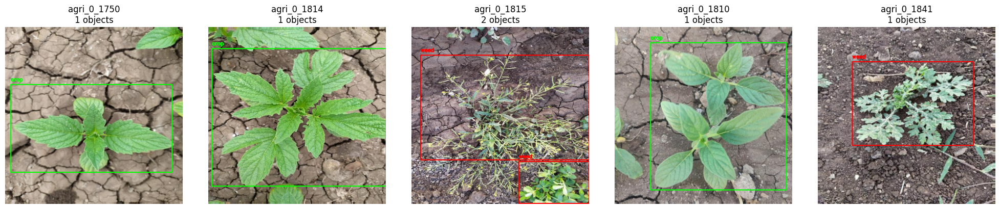

In [ ]:
# Cell 5: Function to visualize sample images with bounding boxes
def visualize_sample_images(num_samples=5):
    """Visualize sample images with bounding boxes and labels"""
    if len(image_filenames) == 0:
        print("No images found to visualize!")
        return

    fig, axes = plt.subplots(1, min(num_samples, 5), figsize=(20, 4))
    if num_samples == 1:
        axes = [axes]

    samples_to_show = min(num_samples, len(image_filenames), 5)

    for i in range(samples_to_show):
        image_filename = image_filenames[i]

        # Read image
        image_path = os.path.join(data_dir, image_filename + '.jpeg')
        image = cv2.imread(image_path)
        if image is None:
            print(f"Could not load image: {image_path}")
            continue

        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        display_image = image.copy()

        # Read annotations if available
        label_path = os.path.join(data_dir, image_filename + '.txt')
        if os.path.exists(label_path):
            with open(label_path, 'r') as file:
                lines = file.readlines()
                for line in lines:
                    data = line.strip().split()
                    if len(data) >= 5:  # YOLO format: class x_center y_center width height
                        class_index = int(data[0])
                        x_center = float(data[1])
                        y_center = float(data[2])
                        width = float(data[3])
                        height = float(data[4])

                        # Convert YOLO format to bounding box coordinates
                        img_height, img_width = image.shape[:2]
                        x_min = int((x_center - width/2) * img_width)
                        y_min = int((y_center - height/2) * img_height)
                        x_max = int((x_center + width/2) * img_width)
                        y_max = int((y_center + height/2) * img_height)

                        # Draw bounding box
                        color = (0, 255, 0) if class_index == 0 else (255, 0, 0)  # Green for crop, Red for weed
                        cv2.rectangle(display_image, (x_min, y_min), (x_max, y_max), color, 2)

                        # Add class label
                        class_label = class_names[class_index] if class_index < len(class_names) else f"Class {class_index}"
                        cv2.putText(display_image, class_label, (x_min, max(y_min-10, 10)),
                                   cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

        axes[i].imshow(display_image)
        axes[i].set_title(f'{image_filename}\n{len(lines) if os.path.exists(label_path) else 0} objects')
        axes[i].axis('off')

    plt.tight_layout()
    plt.show()

# Visualize samples
print("Visualizing sample images...")
visualize_sample_images(5)

In [ ]:
# Cell 6: Load and preprocess data
def load_data(data_dir, image_filenames, target_size=(224, 224)):
    """
    Load images and annotations for classification
    """
    X = []
    y = []  # Dominant class for each image

    print("Loading data...")

    for i, filename in enumerate(image_filenames):
        if i % 100 == 0:  # Progress indicator
            print(f"Processed {i}/{len(image_filenames)} images...")

        # Load and resize image
        image_path = os.path.join(data_dir, filename + '.jpeg')
        image = cv2.imread(image_path)
        if image is None:
            print(f"Warning: Could not load image {image_path}")
            continue

        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image_resized = cv2.resize(image, target_size)
        X.append(image_resized)

        # Determine dominant class (use first object's class)
        label_path = os.path.join(data_dir, filename + '.txt')
        dominant_class = 0  # Default to first class (crop)

        if os.path.exists(label_path):
            with open(label_path, 'r') as file:
                lines = file.readlines()
                if lines:
                    first_line = lines[0].strip().split()
                    if len(first_line) >= 1:
                        dominant_class = int(first_line[0])
                        # Ensure class index is valid
                        if dominant_class >= len(class_names):
                            dominant_class = 0

        y.append(dominant_class)

    X_array = np.array(X)
    y_array = np.array(y)

    print(f"Loaded {len(X_array)} images")
    print(f"X shape: {X_array.shape}")
    print(f"y shape: {y_array.shape}")

    return X_array, y_array

# Load the data
target_size = (224, 224)
X, y = load_data(data_dir, image_filenames, target_size)

Loading data...
Processed 0/1300 images...
Processed 100/1300 images...
Processed 200/1300 images...
Processed 300/1300 images...
Processed 400/1300 images...
Processed 500/1300 images...
Processed 600/1300 images...
Processed 700/1300 images...
Processed 800/1300 images...
Processed 900/1300 images...
Processed 1000/1300 images...
Processed 1100/1300 images...
Processed 1200/1300 images...
Loaded 1300 images
X shape: (1300, 224, 224, 3)
y shape: (1300,)


Class distribution in dataset:
Class crop (0): 634 images (48.8%)
Class weed (1): 666 images (51.2%)


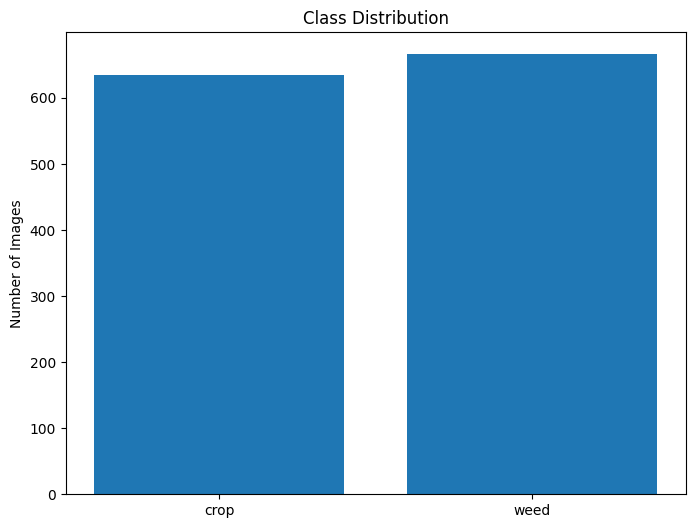

In [ ]:
# Cell 7: Analyze class distribution
if len(X) > 0:
    class_counts = Counter(y)
    print("Class distribution in dataset:")
    for class_idx in range(len(class_names)):
        count = class_counts.get(class_idx, 0)
        percentage = (count / len(y)) * 100 if len(y) > 0 else 0
        print(f"Class {class_names[class_idx]} ({class_idx}): {count} images ({percentage:.1f}%)")

    plt.figure(figsize=(8, 6))
    plt.bar(class_names, [class_counts.get(i, 0) for i in range(len(class_names))])
    plt.title('Class Distribution')
    plt.ylabel('Number of Images')
    plt.show()
else:
    print("No data loaded. Please check the data directory path.")

In [ ]:
# Cell 8: Split the data
if len(X) > 0:
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.2, random_state=42, shuffle=True, stratify=y
    )

    print("Training set shape:", X_train.shape)
    print("Test set shape:", X_test.shape)
    print("Training labels shape:", y_train.shape)
    print("Test labels shape:", y_test.shape)

    # Check distribution in splits
    train_counts = Counter(y_train)
    test_counts = Counter(y_test)

    print("\nTraining set distribution:")
    for class_idx in range(len(class_names)):
        count = train_counts.get(class_idx, 0)
        percentage = (count / len(y_train)) * 100 if len(y_train) > 0 else 0
        print(f"Class {class_names[class_idx]}: {count} images ({percentage:.1f}%)")

    print("\nTest set distribution:")
    for class_idx in range(len(class_names)):
        count = test_counts.get(class_idx, 0)
        percentage = (count / len(y_test)) * 100 if len(y_test) > 0 else 0
        print(f"Class {class_names[class_idx]}: {count} images ({percentage:.1f}%)")
else:
    print("Cannot split data - no images loaded.")

Training set shape: (1040, 224, 224, 3)
Test set shape: (260, 224, 224, 3)
Training labels shape: (1040,)
Test labels shape: (260,)

Training set distribution:
Class crop: 507 images (48.8%)
Class weed: 533 images (51.2%)

Test set distribution:
Class crop: 127 images (48.8%)
Class weed: 133 images (51.2%)


In [ ]:
# Cell 9: Build the classification model
def create_classification_model(input_shape=(224, 224, 3), num_classes=2):
    model = tf.keras.Sequential([
        layers.Input(shape=input_shape),
        layers.Rescaling(scale=1./255),

        # First conv block
        layers.Conv2D(32, (3, 3), activation='relu', padding='same'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
        layers.Dropout(0.25),

        # Second conv block
        layers.Conv2D(64, (3, 3), activation='relu', padding='same'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
        layers.Dropout(0.25),

        # Third conv block
        layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
        layers.Dropout(0.25),

        # Global pooling and dense layers
        layers.GlobalAveragePooling2D(),
        layers.Dense(128, activation='relu'),
        layers.BatchNormalization(),
        layers.Dropout(0.5),
        layers.Dense(num_classes, activation='softmax')
    ])

    return model

if len(X) > 0:
    classification_model = create_classification_model(num_classes=len(class_names))
    classification_model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
        loss='sparse_categorical_crossentropy',
        metrics=['accuracy']
    )

    classification_model.summary()
else:
    print("Cannot create model - no data available.")

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ rescaling (Rescaling)           │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 224, 224, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 224, 224, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 112, 112, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 112, 112, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 112, 112, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 112, 112, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 56, 56, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 56, 56, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 56, 56, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 56, 56, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 28, 28, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 28, 28, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 128)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │        16,512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │           258 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 111,426 (435.26 KB)

 Trainable params: 110,722 (432.51 KB)

 Non-trainable params: 704 (2.75 KB)

In [ ]:
# Cell 10: Train the classification model
print("Starting model training...")

# Callbacks for better training
callbacks = [
    tf.keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True),
    tf.keras.callbacks.ReduceLROnPlateau(factor=0.2, patience=3, min_lr=1e-7)
]

# Train the model
history = classification_model.fit(
    X_train, y_train,
    batch_size=32,
    epochs=30,
    validation_data=(X_test, y_test),
    callbacks=callbacks,
    verbose=1
)

print("Model training completed!")

Starting model training...
Epoch 1/30
33/33 ━━━━━━━━━━━━━━━━━━━━ 252s 7s/step - accuracy: 0.8164 - loss: 0.4936 - val_accuracy: 0.4885 - val_loss: 0.6917 - learning_rate: 0.0010
Epoch 2/30
33/33 ━━━━━━━━━━━━━━━━━━━━ 237s 7s/step - accuracy: 0.9117 - loss: 0.2525 - val_accuracy: 0.4885 - val_loss: 0.7115 - learning_rate: 0.0010
Epoch 3/30
33/33 ━━━━━━━━━━━━━━━━━━━━ 283s 7s/step - accuracy: 0.9167 - loss: 0.2280 - val_accuracy: 0.5269 - val_loss: 0.6653 - learning_rate: 0.0010
Epoch 4/30
33/33 ━━━━━━━━━━━━━━━━━━━━ 254s 7s/step - accuracy: 0.9364 - loss: 0.2464 - val_accuracy: 0.6308 - val_loss: 0.6441 - learning_rate: 0.0010
Epoch 5/30
33/33 ━━━━━━━━━━━━━━━━━━━━ 225s 7s/step - accuracy: 0.9421 - loss: 0.1989 - val_accuracy: 0.5115 - val_loss: 0.6488 - learning_rate: 0.0010
Epoch 6/30
33/33 ━━━━━━━━━━━━━━━━━━━━ 262s 7s/step - accuracy: 0.9379 - loss: 0.2237 - val_accuracy: 0.7077 - val_loss: 0.5863 - learning_rate: 0.0010
Epoch 7/30
33/33 ━━━━━━━━━━━━━━━━━━━━ 223s 7s/step - accuracy: 0.94

=== MODEL EVALUATION ===
Test Accuracy: 0.7077
Test Loss: 0.5863
9/9 ━━━━━━━━━━━━━━━━━━━━ 12s 1s/step

=== CLASSIFICATION REPORT ===
              precision    recall  f1-score   support

        crop       0.83      0.50      0.63       127
        weed       0.66      0.90      0.76       133

    accuracy                           0.71       260
   macro avg       0.74      0.70      0.69       260
weighted avg       0.74      0.71      0.69       260



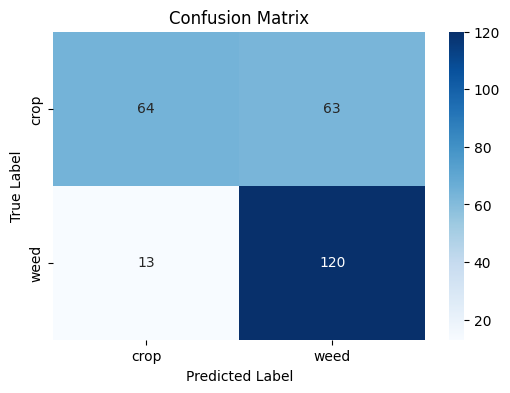

In [ ]:
# Cell 11: Evaluate the model
test_loss, test_accuracy = classification_model.evaluate(X_test, y_test, verbose=0)
print(f"=== MODEL EVALUATION ===")
print(f"Test Accuracy: {test_accuracy:.4f}")
print(f"Test Loss: {test_loss:.4f}")

# Make predictions on test set
y_pred = classification_model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

# Calculate additional metrics
from sklearn.metrics import classification_report, confusion_matrix

print("\n=== CLASSIFICATION REPORT ===")
print(classification_report(y_test, y_pred_classes, target_names=class_names))

# Confusion matrix
cm = confusion_matrix(y_test, y_pred_classes)
plt.figure(figsize=(6, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

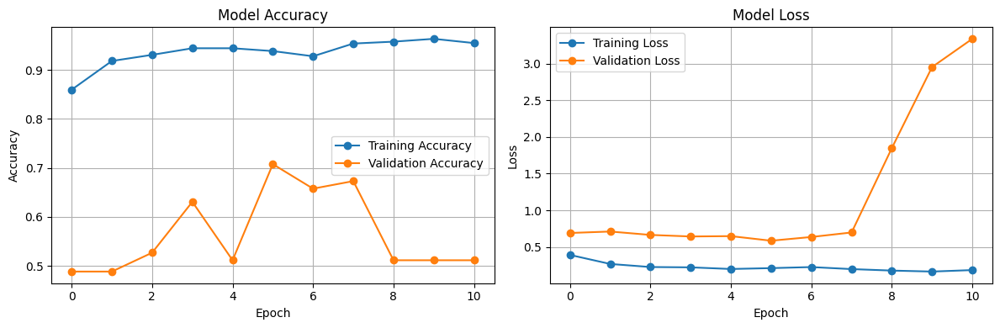

In [ ]:
# Cell 12: Plot training history
def plot_training_history(history):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

    # Plot accuracy
    ax1.plot(history.history['accuracy'], label='Training Accuracy', marker='o')
    ax1.plot(history.history['val_accuracy'], label='Validation Accuracy', marker='o')
    ax1.set_title('Model Accuracy')
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Accuracy')
    ax1.legend()
    ax1.grid(True)

    # Plot loss
    ax2.plot(history.history['loss'], label='Training Loss', marker='o')
    ax2.plot(history.history['val_loss'], label='Validation Loss', marker='o')
    ax2.set_title('Model Loss')
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Loss')
    ax2.legend()
    ax2.grid(True)

    plt.tight_layout()
    plt.show()

plot_training_history(history)

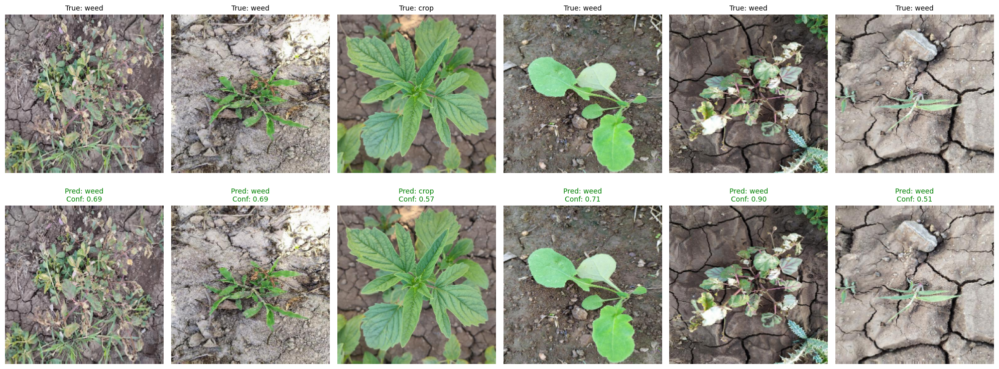

Accuracy on 6 random samples: 6/6 (100.0%)


In [ ]:
# Cell 13: Test the model on sample images from test set
def test_sample_predictions(model, X_test, y_test, class_names, num_samples=6):
    """
    Test the model on samples from the test set
    """
    # Get random samples
    indices = np.random.choice(len(X_test), num_samples, replace=False)

    fig, axes = plt.subplots(2, num_samples, figsize=(20, 8))
    if num_samples == 1:
        axes = axes.reshape(2, 1)

    for i, idx in enumerate(indices):
        test_image = X_test[idx]
        true_label = y_test[idx]

        # Make prediction
        image_batch = np.expand_dims(test_image, axis=0)
        prediction = model.predict(image_batch, verbose=0)
        predicted_class = np.argmax(prediction[0])
        confidence = np.max(prediction[0])

        # Display original image (top row)
        axes[0, i].imshow(test_image)
        axes[0, i].set_title(f'True: {class_names[true_label]}', fontsize=10)
        axes[0, i].axis('off')

        # Display prediction (bottom row)
        axes[1, i].imshow(test_image)
        color = 'green' if predicted_class == true_label else 'red'
        title = f'Pred: {class_names[predicted_class]}\nConf: {confidence:.2f}'
        axes[1, i].set_title(title, color=color, fontsize=10)
        axes[1, i].axis('off')

    plt.tight_layout()
    plt.show()

    # Print accuracy on these samples
    correct = sum(1 for i, idx in enumerate(indices) if y_test[idx] == np.argmax(model.predict(np.expand_dims(X_test[idx], axis=0), verbose=0)))
    print(f"Accuracy on {num_samples} random samples: {correct}/{num_samples} ({correct/num_samples*100:.1f}%)")

test_sample_predictions(classification_model, X_test, y_test, class_names, 6)

In [ ]:
# Cell 14: Create prediction function for new images
def predict_image(model, image_path, class_names, target_size=(224, 224)):
    """
    Predict crop/weed on a single image
    """
    # Load image
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error: Could not load image from {image_path}")
        return None, None, None

    original_image = image.copy()
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Resize for model
    image_resized = cv2.resize(image, target_size)
    image_normalized = image_resized / 255.0
    image_batch = np.expand_dims(image_normalized, axis=0)

    # Make prediction
    predictions = model.predict(image_batch, verbose=0)
    predicted_class = np.argmax(predictions[0])
    confidence = np.max(predictions[0])

    return original_image, class_names[predicted_class], confidence

def visualize_prediction(original_image, prediction, confidence, class_names):
    """
    Visualize the prediction result
    """
    image_rgb = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(10, 6))
    plt.imshow(image_rgb)

    # Add prediction text
    color = 'green' if prediction == class_names[0] else 'red'
    plt.title(f'Prediction: {prediction} | Confidence: {confidence:.2f}',
              color=color, fontsize=16, pad=20)
    plt.axis('off')

    # Add border color based on prediction
    for spine in plt.gca().spines.values():
        spine.set_color(color)
        spine.set_linewidth(3)

    plt.tight_layout()
    plt.show()

Testing on sample image: agri_0_1815


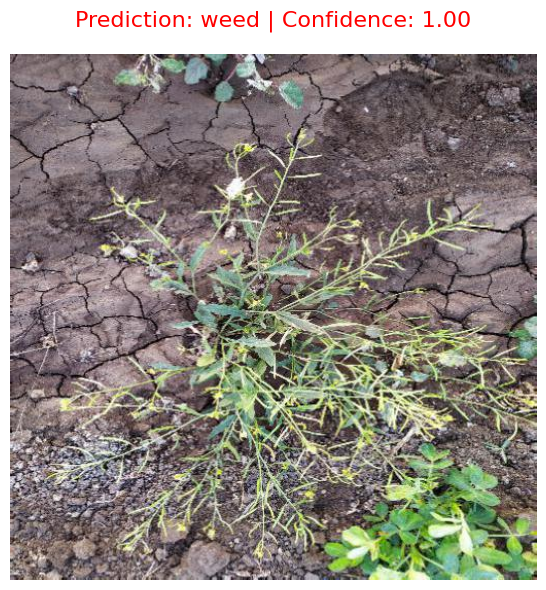

Prediction: weed
Confidence: 1.00


In [ ]:
# Cell 15: Test on a sample image from the dataset
# Use first image from test set as example
sample_idx = 2
sample_image_path = os.path.join(data_dir, image_filenames[sample_idx] + '.jpeg')

print(f"Testing on sample image: {image_filenames[sample_idx]}")
original_image, prediction, confidence = predict_image(classification_model, sample_image_path, class_names)

if original_image is not None:
    visualize_prediction(original_image, prediction, confidence, class_names)
    print(f"Prediction: {prediction}")
    print(f"Confidence: {confidence:.2f}")

In [ ]:
# Cell 17: Create a complete prediction pipeline
def complete_prediction_pipeline(image_path, model=None):
    """
    Complete pipeline for predicting on user-provided images
    """
    if model is None:
        # Load the saved model
        model = tf.keras.models.load_model('crop_weed_classification_model.h5')

    original_image, prediction, confidence = predict_image(model, image_path, class_names)

    if original_image is not None:
        visualize_prediction(original_image, prediction, confidence, class_names)

        print("="*50)
        print("PREDICTION RESULTS")
        print("="*50)
        print(f"Image: {os.path.basename(image_path)}")
        print(f"Prediction: {prediction}")
        print(f"Confidence: {confidence:.3f}")
        print(f"Image size: {original_image.shape[1]}x{original_image.shape[0]}")
        print("="*50)

        # Interpretation
        if confidence > 0.8:
            confidence_level = "HIGH"
        elif confidence > 0.6:
            confidence_level = "MEDIUM"
        else:
            confidence_level = "LOW"

        print(f"Confidence Level: {confidence_level}")

        if prediction == class_names[0]:  # Crop
            print("✅ This image appears to contain primarily CROPS")
        else:  # Weed
            print("⚠️ This image appears to contain primarily WEEDS")

    return original_image, prediction, confidence

# Example of how to use:
print("Prediction pipeline ready!")
print("\nTo use: complete_prediction_pipeline('/content/drive/MyDrive/archive (2)/agri_data/data/agri_0_1009.jpeg')")

Prediction pipeline ready!

To use: complete_prediction_pipeline('path/to/your/image.jpg')


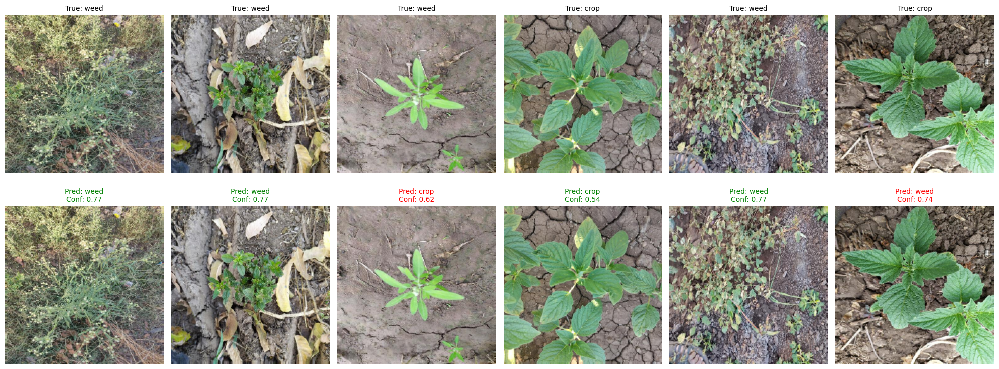

Accuracy on 6 random samples: 4/6 (66.7%)


In [ ]:
# Cell 13: Test the model on sample images from test set
def test_sample_predictions(model, X_test, y_test, class_names, num_samples=6):
    """
    Test the model on samples from the test set
    """
    # Get random samples
    indices = np.random.choice(len(X_test), num_samples, replace=False)

    fig, axes = plt.subplots(2, num_samples, figsize=(20, 8))
    if num_samples == 1:
        axes = axes.reshape(2, 1)

    for i, idx in enumerate(indices):
        test_image = X_test[idx]
        true_label = y_test[idx]

        # Make prediction
        image_batch = np.expand_dims(test_image, axis=0)
        prediction = model.predict(image_batch, verbose=0)
        predicted_class = np.argmax(prediction[0])
        confidence = np.max(prediction[0])

        # Display original image (top row)
        axes[0, i].imshow(test_image)
        axes[0, i].set_title(f'True: {class_names[true_label]}', fontsize=10)
        axes[0, i].axis('off')

        # Display prediction (bottom row)
        axes[1, i].imshow(test_image)
        color = 'green' if predicted_class == true_label else 'red'
        title = f'Pred: {class_names[predicted_class]}\nConf: {confidence:.2f}'
        axes[1, i].set_title(title, color=color, fontsize=10)
        axes[1, i].axis('off')

    plt.tight_layout()
    plt.show()

    # Print accuracy on these samples
    correct = sum(1 for i, idx in enumerate(indices) if y_test[idx] == np.argmax(model.predict(np.expand_dims(X_test[idx], axis=0), verbose=0)))
    print(f"Accuracy on {num_samples} random samples: {correct}/{num_samples} ({correct/num_samples*100:.1f}%)")

test_sample_predictions(classification_model, X_test, y_test, class_names, 6)

In [ ]:
# Cell 16: Save the model
# Save the trained model
model_save_path = 'crop_weed_classification_model.h5'
classification_model.save(model_save_path)
print(f"Model saved successfully as {model_save_path}")

# Save class names for future use
import json
class_info = {
    'class_names': class_names,
    'input_shape': (224, 224, 3)
}

with open('class_info.json', 'w') as f:
    json.dump(class_info, f)
print("Class information saved successfully!")

Model saved successfully as crop_weed_classification_model.h5
Class information saved successfully!


In [ ]:
# Cell 17: Create a complete prediction pipeline
def complete_prediction_pipeline(image_path, model=None):
    """
    Complete pipeline for predicting on user-provided images
    """
    if model is None:
        # Load the saved model
        model = tf.keras.models.load_model('crop_weed_classification_model.h5')

    original_image, prediction, confidence = predict_image(model, image_path, class_names)

    if original_image is not None:
        visualize_prediction(original_image, prediction, confidence, class_names)

        print("="*50)
        print("PREDICTION RESULTS")
        print("="*50)
        print(f"Image: {os.path.basename(image_path)}")
        print(f"Prediction: {prediction}")
        print(f"Confidence: {confidence:.3f}")
        print(f"Image size: {original_image.shape[1]}x{original_image.shape[0]}")
        print("="*50)

        # Interpretation
        if confidence > 0.8:
            confidence_level = "HIGH"
        elif confidence > 0.6:
            confidence_level = "MEDIUM"
        else:
            confidence_level = "LOW"

        print(f"Confidence Level: {confidence_level}")

        if prediction == class_names[0]:  # Crop
            print("✅ This image appears to contain primarily CROPS")
        else:  # Weed
            print("⚠️ This image appears to contain primarily WEEDS")

    return original_image, prediction, confidence

# Example of how to use:
print("Prediction pipeline ready!")
print("\nTo use: complete_prediction_pipeline('/content/drive/MyDrive/archive (2)/agri_data/data/agri_0_1009.jpeg')")

Prediction pipeline ready!

To use: complete_prediction_pipeline('/content/drive/MyDrive/archive (2)/agri_data/data/agri_0_1009.jpeg')


Testing pipeline with multiple samples...

--- Testing image 1: agri_0_1750 ---


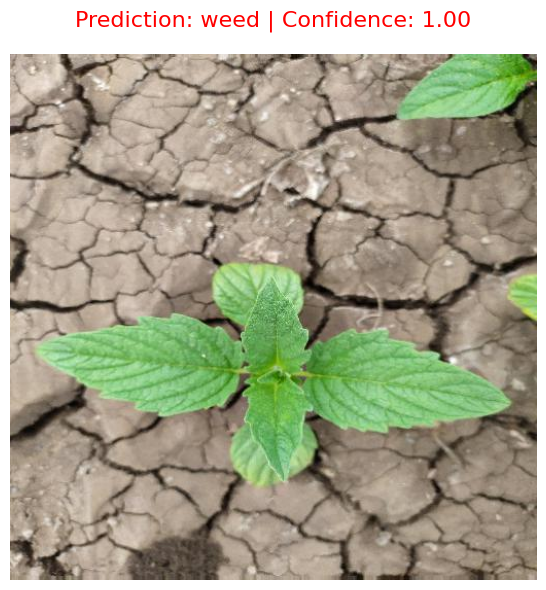

PREDICTION RESULTS
Image: agri_0_1750.jpeg
Prediction: weed
Confidence: 0.999
Image size: 512x512
Confidence Level: HIGH
⚠️ This image appears to contain primarily WEEDS



--- Testing image 2: agri_0_1814 ---


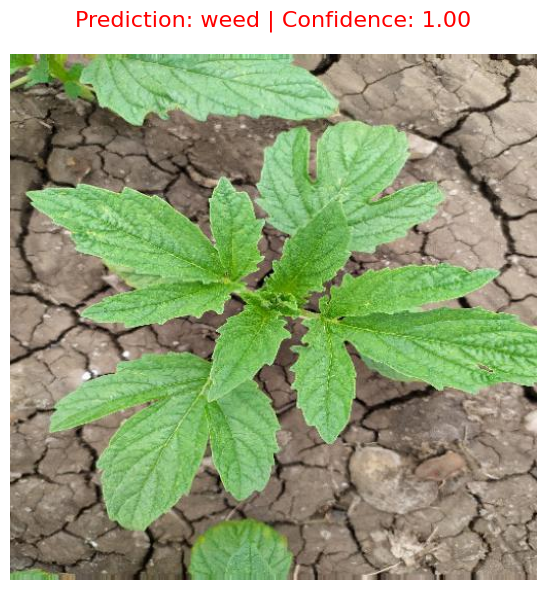

PREDICTION RESULTS
Image: agri_0_1814.jpeg
Prediction: weed
Confidence: 0.999
Image size: 512x512
Confidence Level: HIGH
⚠️ This image appears to contain primarily WEEDS



--- Testing image 3: agri_0_1815 ---


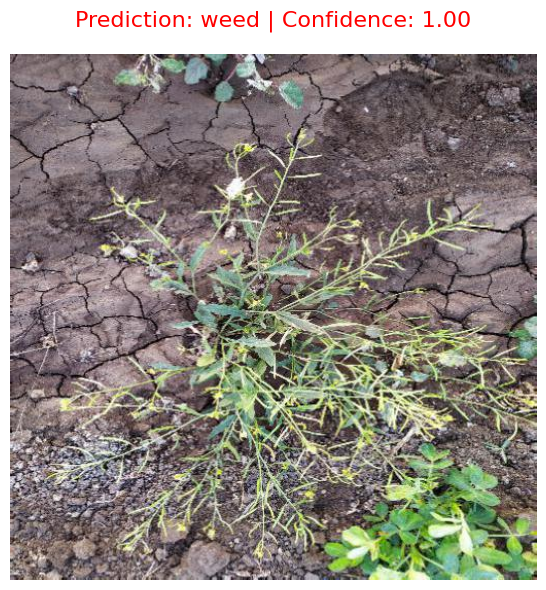

PREDICTION RESULTS
Image: agri_0_1815.jpeg
Prediction: weed
Confidence: 0.999
Image size: 512x512
Confidence Level: HIGH
⚠️ This image appears to contain primarily WEEDS




In [ ]:
# Cell 18: Test the pipeline with multiple sample images
print("Testing pipeline with multiple samples...")

# Test with first 3 images from the dataset
for i in range(3):
    if i < len(image_filenames):
        image_path = os.path.join(data_dir, image_filenames[i] + '.jpeg')
        print(f"\n--- Testing image {i+1}: {image_filenames[i]} ---")
        complete_prediction_pipeline(image_path, classification_model)
        print("\n")

In [ ]:
# Cell 19: Final summary and usage instructions
print("="*60)
print("CROP AND WEED DETECTION SYSTEM - SUMMARY")
print("="*60)

print(f"\nModel Performance:")
print(f"- Test Accuracy: {test_accuracy:.3f}")
print(f"- Number of training images: {len(X_train)}")
print(f"- Number of test images: {len(X_test)}")

print(f"\nClasses detected:")
for i, class_name in enumerate(class_names):
    count = list(y).count(i)
    print(f"- {class_name}: {count} images")

print(f"\nUsage Instructions:")
print("1. Use complete_prediction_pipeline('path/to/image.jpg') for new images")
print("2. The model will classify the image as crop or weed")
print("3. Results include confidence score and visualization")

print(f"\nModel saved as: crop_weed_classification_model.h5")
print("Class information saved as: class_info.json")

print("\n✅ System ready for use!")

CROP AND WEED DETECTION SYSTEM - SUMMARY

Model Performance:
- Test Accuracy: 0.708
- Number of training images: 1040
- Number of test images: 260

Classes detected:
- crop: 634 images
- weed: 666 images

Usage Instructions:
1. Use complete_prediction_pipeline('path/to/image.jpg') for new images
2. The model will classify the image as crop or weed
3. Results include confidence score and visualization

Model saved as: crop_weed_classification_model.h5
Class information saved as: class_info.json

✅ System ready for use!


In [ ]:
# Cell 1: Import libraries for detection and visualization
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras import layers
import os

print("Detection libraries imported!")

Detection libraries imported!


In [ ]:
# Cell 2: Load the trained model and class names
# Load your trained model (replace with your actual model path)
model = tf.keras.models.load_model('crop_weed_classification_model.h5')
class_names = ['crop', 'weed']  # Replace with your actual class names

print("Model and class names loaded!")

Model and class names loaded!


In [ ]:
# Cell 3: Function to detect and draw bounding boxes on crops/weeds
def detect_and_mark_crops_weeds(image_path, model, class_names, confidence_threshold=0.5):
    """
    Detect crops and weeds in an image and draw bounding boxes around them
    """
    # Load image
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error: Could not load image from {image_path}")
        return None

    original_image = image.copy()
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    height, width = image.shape[:2]

    # Method 1: Sliding window approach for detection
    window_size = 100
    stride = 50

    detections = []

    # Slide window over the image
    for y in range(0, height - window_size, stride):
        for x in range(0, width - window_size, stride):
            # Extract window
            window = image_rgb[y:y + window_size, x:x + window_size]

            # Preprocess window for prediction
            window_resized = cv2.resize(window, (224, 224))
            window_normalized = window_resized / 255.0
            window_expanded = np.expand_dims(window_normalized, axis=0)

            # Predict
            prediction = model.predict(window_expanded, verbose=0)
            class_id = np.argmax(prediction[0])
            confidence = np.max(prediction[0])

            # Only consider high confidence detections
            if confidence > confidence_threshold:
                detections.append({
                    'x': x, 'y': y, 'w': window_size, 'h': window_size,
                    'class': class_id, 'confidence': confidence
                })

    # Draw detections on image
    result_image = image_rgb.copy()

    # Colors for different classes
    class_colors = {
        0: (0, 255, 0),    # Green for crop
        1: (255, 0, 0)     # Red for weed
    }

    for detection in detections:
        x, y, w, h = detection['x'], detection['y'], detection['w'], detection['h']
        class_id = detection['class']
        confidence = detection['confidence']

        color = class_colors[class_id]
        label = f"{class_names[class_id]} ({confidence:.2f})"

        # Draw rectangle
        cv2.rectangle(result_image, (x, y), (x + w, y + h), color, 3)

        # Add label background
        label_size = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.6, 2)[0]
        cv2.rectangle(result_image, (x, y - label_size[1] - 10),
                     (x + label_size[0], y), color, -1)

        # Add text
        cv2.putText(result_image, label, (x, y - 5),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)

    return result_image, detections

In [ ]:
# Cell 4: Alternative method using contour detection + classification
def detect_with_contours(image_path, model, class_names, confidence_threshold=0.7):
    """
    Use contour detection to find plant regions, then classify each region
    """
    # Load image
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error: Could not load image from {image_path}")
        return None

    original_image = image.copy()
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    height, width = image.shape[:2]

    # Convert to HSV for better plant detection
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Define green color range for plants
    lower_green = np.array([35, 50, 50])
    upper_green = np.array([85, 255, 255])

    # Create mask for green areas (plants)
    mask = cv2.inRange(hsv, lower_green, upper_green)

    # Clean up the mask
    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    # Find contours
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    detections = []
    result_image = image_rgb.copy()

    # Colors for different classes
    class_colors = {
        0: (0, 255, 0),    # Green for crop
        1: (255, 0, 0)     # Red for weed
    }

    for contour in contours:
        # Filter by area
        area = cv2.contourArea(contour)
        if area < 500:  # Skip small contours
            continue

        # Get bounding rectangle
        x, y, w, h = cv2.boundingRect(contour)

        # Extract region of interest
        roi = image_rgb[y:y+h, x:x+w]
        if roi.size == 0:
            continue

        # Preprocess ROI for classification
        roi_resized = cv2.resize(roi, (224, 224))
        roi_normalized = roi_resized / 255.0
        roi_expanded = np.expand_dims(roi_normalized, axis=0)

        # Classify the region
        prediction = model.predict(roi_expanded, verbose=0)
        class_id = np.argmax(prediction[0])
        confidence = np.max(prediction[0])

        if confidence > confidence_threshold:
            detections.append({
                'x': x, 'y': y, 'w': w, 'h': h,
                'class': class_id, 'confidence': confidence,
                'area': area
            })

            # Draw bounding box
            color = class_colors[class_id]
            label = f"{class_names[class_id]} ({confidence:.2f})"

            # Draw rectangle
            cv2.rectangle(result_image, (x, y), (x + w, y + h), color, 3)

            # Add label
            label_size = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.6, 2)[0]
            cv2.rectangle(result_image, (x, y - label_size[1] - 10),
                         (x + label_size[0], y), color, -1)
            cv2.putText(result_image, label, (x, y - 5),
                       cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)

    return result_image, detections

In [ ]:
# Cell 5: Enhanced detection with multiple methods
def enhanced_crop_weed_detection(image_path, model, class_names, method='contour', confidence_threshold=0.6):
    """
    Enhanced detection with multiple methods available
    """
    if method == 'sliding_window':
        return detect_and_mark_crops_weeds(image_path, model, class_names, confidence_threshold)
    elif method == 'contour':
        return detect_with_contours(image_path, model, class_names, confidence_threshold)
    else:
        print("Invalid method. Using contour method.")
        return detect_with_contours(image_path, model, class_names, confidence_threshold)

In [ ]:
# Cell 6: Function to visualize results
def visualize_detection_results(original_image, detected_image, detections, class_names):
    """
    Visualize original and detected images side by side
    """
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

    # Original image
    ax1.imshow(original_image)
    ax1.set_title('Original Image')
    ax1.axis('off')

    # Detected image
    ax2.imshow(detected_image)
    ax2.set_title(f'Detected: {len(detections)} objects found')
    ax2.axis('off')

    plt.tight_layout()
    plt.show()

    # Print detection summary
    print(f"\n=== DETECTION SUMMARY ===")
    print(f"Total objects detected: {len(detections)}")

    for class_id in range(len(class_names)):
        class_detections = [d for d in detections if d['class'] == class_id]
        print(f"{class_names[class_id]}: {len(class_detections)}")

        if class_detections:
            avg_confidence = np.mean([d['confidence'] for d in class_detections])
            print(f"  Average confidence: {avg_confidence:.3f}")

In [ ]:
# Cell 7: Complete detection pipeline
def detect_crops_weeds_pipeline(image_path, model, class_names, method='contour', confidence_threshold=0.6):
    """
    Complete pipeline for detecting and marking crops/weeds in an image
    """
    # Load original image for comparison
    original_image = cv2.imread(image_path)
    if original_image is None:
        print(f"Error: Could not load image from {image_path}")
        return

    original_image_rgb = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)

    # Perform detection
    print(f"Detecting crops and weeds using {method} method...")
    detected_image, detections = enhanced_crop_weed_detection(
        image_path, model, class_names, method, confidence_threshold
    )

    if detected_image is not None:
        # Visualize results
        visualize_detection_results(original_image_rgb, detected_image, detections, class_names)

        # Return results for further use
        return detected_image, detections
    else:
        print("Detection failed!")
        return None, []

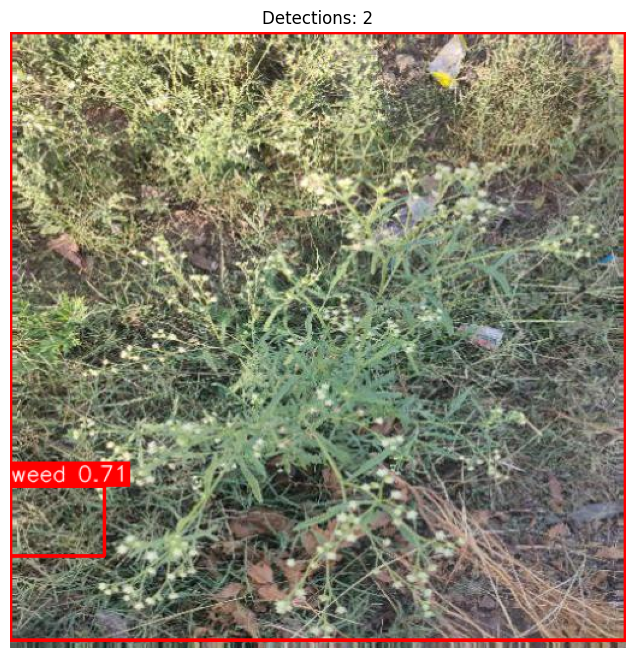

Detection completed successfully!
Found 2 objects


In [ ]:
# Cell 8: Test the detection on a sample image
# Replace with your actual image path
sample_image_path = "/content/drive/MyDrive/archive (2)/agri_data/data/agri_0_1210.jpeg"


# Test with contour method (better for plant detection)
detected_img, detections = detect_crops_weeds_pipeline(
    sample_image_path,
    model,
    class_names,
    method='contour',
    confidence_threshold=0.7
)

if detected_img is not None:
    print("Detection completed successfully!")
    print(f"Found {len(detections)} objects")

Found 1300 images. Processing first 3...

--- Processing 1/3: agri_0_1750.jpeg ---
Detecting crops and weeds using contour method...


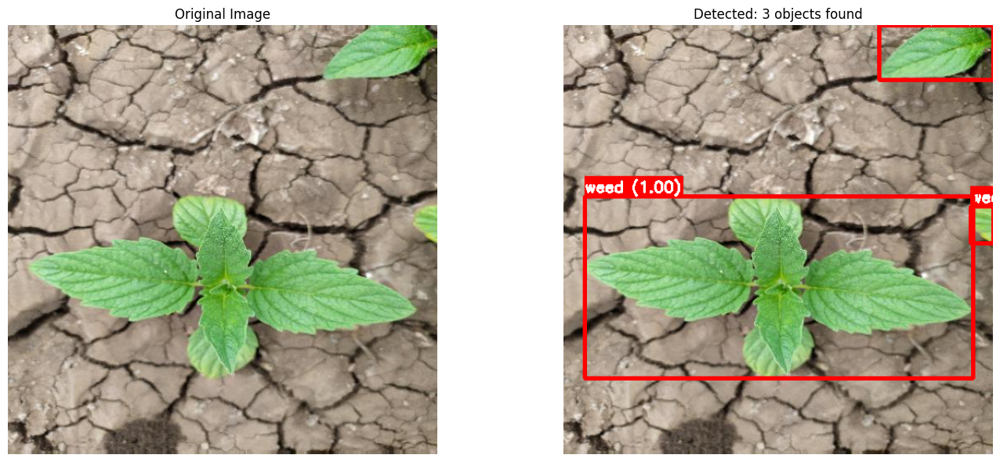


=== DETECTION SUMMARY ===
Total objects detected: 3
crop: 0
weed: 3
  Average confidence: 0.999

--- Processing 2/3: agri_0_1814.jpeg ---
Detecting crops and weeds using contour method...


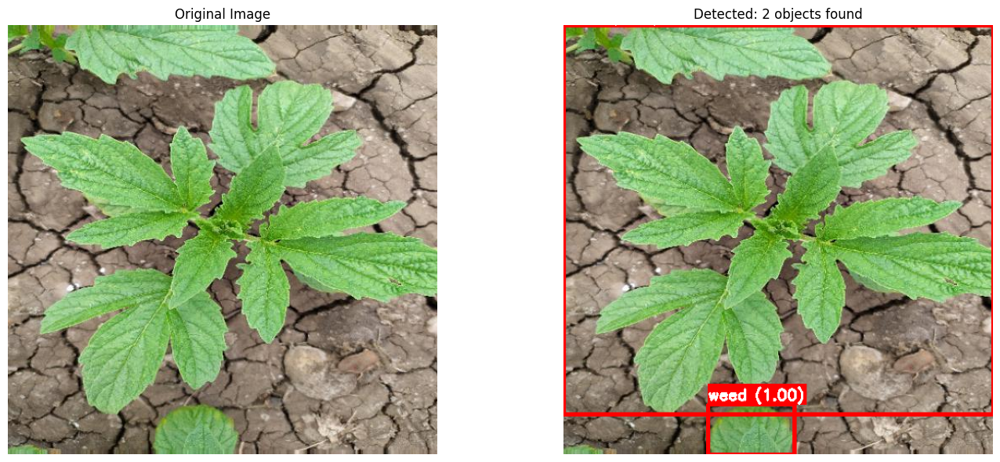


=== DETECTION SUMMARY ===
Total objects detected: 2
crop: 0
weed: 2
  Average confidence: 0.999

--- Processing 3/3: agri_0_1815.jpeg ---
Detecting crops and weeds using contour method...


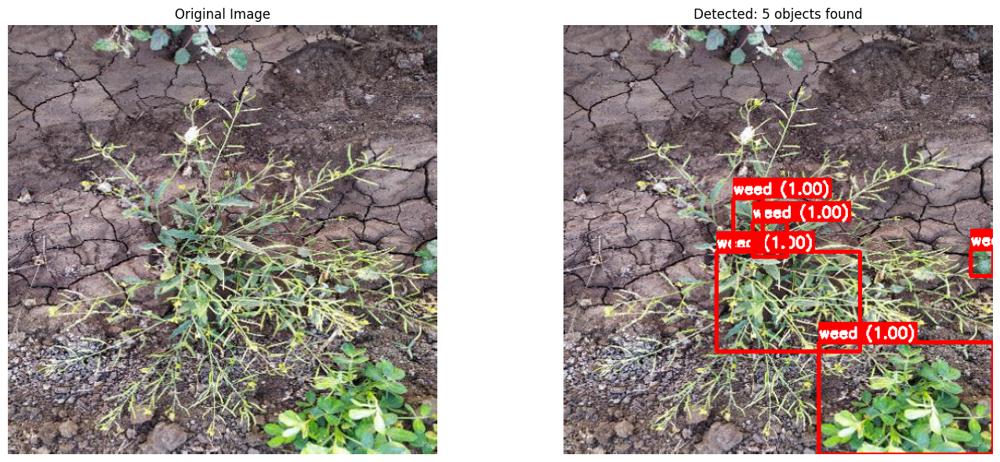


=== DETECTION SUMMARY ===
Total objects detected: 5
crop: 0
weed: 5
  Average confidence: 0.999


In [ ]:
# Cell 9: Batch detection on multiple images
def batch_detect_images(image_folder, model, class_names, max_images=5):
    """
    Detect crops/weeds in multiple images
    """
    image_extensions = ['.jpg', '.jpeg', '.png', '.bmp']
    image_files = [f for f in os.listdir(image_folder)
                  if any(f.lower().endswith(ext) for ext in image_extensions)]

    if not image_files:
        print("No images found in the folder!")
        return

    print(f"Found {len(image_files)} images. Processing first {min(max_images, len(image_files))}...")

    for i, image_file in enumerate(image_files[:max_images]):
        image_path = os.path.join(image_folder, image_file)
        print(f"\n--- Processing {i+1}/{min(max_images, len(image_files))}: {image_file} ---")

        detected_img, detections = detect_crops_weeds_pipeline(
            image_path, model, class_names, method='contour', confidence_threshold=0.7
        )

# Example usage:
batch_detect_images("//content/drive/MyDrive/archive (2)/agri_data/data", model, class_names, max_images=3)

=== CROP AND WEED DETECTION ===
Please upload an image file (jpg, jpeg, png)


Saving Test_43.jpg to Test_43.jpg
File uploaded: Test_43.jpg


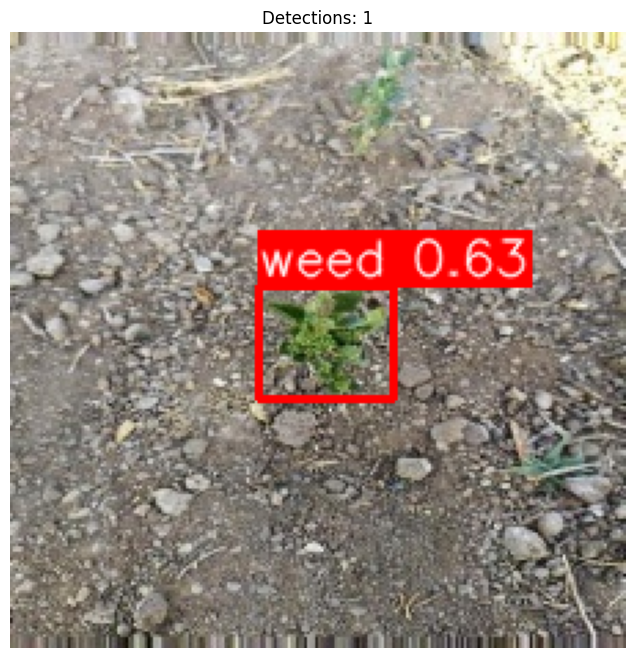

In [ ]:
# Cell 1: File upload widget for user input
from google.colab import files
import cv2
import matplotlib.pyplot as plt
import tempfile
import os

def upload_and_detect():
    """Allow user to upload an image and detect crops/weeds"""
    print("=== CROP AND WEED DETECTION ===")
    print("Please upload an image file (jpg, jpeg, png)")

    # Upload file
    uploaded = files.upload()

    if not uploaded:
        print("No file uploaded!")
        return

    # Get the uploaded file
    uploaded_filename = list(uploaded.keys())[0]
    print(f"File uploaded: {uploaded_filename}")

    # Create temporary file path
    temp_path = os.path.join(tempfile.gettempdir(), uploaded_filename)

    # Save uploaded file
    with open(temp_path, 'wb') as f:
        f.write(uploaded[uploaded_filename])

    # Perform detection
    detected_image, detections = detect_crops_weeds_pipeline(
        temp_path,
        model,
        class_names,
        method='contour',
        confidence_threshold=0.6
    )

    # Clean up temporary file
    os.remove(temp_path)

    return detected_image, detections, uploaded_filename

# Run the upload and detection
result_image, detections, filename = upload_and_detect()

In [ ]:
# Cell 2: Enhanced version with multiple upload options
import ipywidgets as widgets
from IPython.display import display, clear_output
import io
from PIL import Image

def interactive_upload_detection():
    """Interactive file upload with preview and options"""

    # Create upload widget
    uploader = widgets.FileUpload(
        description='Upload Image',
        accept='.jpg,.jpeg,.png,.bmp',
        multiple=False
    )

    # Confidence threshold slider
    confidence_slider = widgets.FloatSlider(
        value=0.6,
        min=0.1,
        max=0.95,
        step=0.05,
        description='Confidence:',
        continuous_update=False
    )

    # Detection method dropdown
    method_dropdown = widgets.Dropdown(
        options=['contour', 'sliding_window'],
        value='contour',
        description='Method:'
    )

    # Detect button
    detect_button = widgets.Button(
        description='Detect Crops/Weeds',
        button_style='success',
        icon='search'
    )

    # Output area
    output = widgets.Output()

    def on_detect_click(b):
        with output:
            clear_output()
            if not uploader.value:
                print("⚠️ Please upload an image first!")
                return

            # Get uploaded file
            uploaded_filename = list(uploader.value.keys())[0]
            file_content = uploader.value[uploaded_filename]['content']

            # Convert to image
            image = Image.open(io.BytesIO(file_content))

            # Save to temporary file
            temp_path = os.path.join(tempfile.gettempdir(), uploaded_filename)
            image.save(temp_path)

            print(f"🔍 Analyzing: {uploaded_filename}")
            print(f"📊 Confidence threshold: {confidence_slider.value}")
            print(f"⚙️ Detection method: {method_dropdown.value}")
            print("⏳ Processing...")

            # Perform detection
            detected_image, detections = detect_crops_weeds_pipeline(
                temp_path,
                model,
                class_names,
                method=method_dropdown.value,
                confidence_threshold=confidence_slider.value
            )

            # Clean up
            os.remove(temp_path)

            print("✅ Detection completed!")

            # Offer download option
            if detected_image is not None:
                save_option = widgets.Button(
                    description='💾 Save Result Image',
                    button_style='info'
                )

                def on_save_click(b):
                    output_path = f"detected_{uploaded_filename}"
                    detected_bgr = cv2.cvtColor(detected_image, cv2.COLOR_RGB2BGR)
                    cv2.imwrite(output_path, detected_bgr)
                    files.download(output_path)
                    print(f"📥 Image saved as: {output_path}")

                save_option.on_click(on_save_click)
                display(save_option)

    detect_button.on_click(on_detect_click)

    # Display widgets
    print("🎯 CROP AND WEED DETECTION SYSTEM")
    print("Upload an image and click detect to find crops and weeds!")

    display(widgets.VBox([
        uploader,
        widgets.HBox([confidence_slider, method_dropdown]),
        detect_button,
        output
    ]))

# Run interactive upload
interactive_upload_detection()

🎯 CROP AND WEED DETECTION SYSTEM
Upload an image and click detect to find crops and weeds!


In [ ]:
# Cell 9: Save and download split dataset
import numpy as np

# Create a folder to store splits
os.makedirs("splitted_dataset", exist_ok=True)

# Save arrays as compressed npz files
np.savez_compressed("splitted_dataset/train_data.npz", X_train=X_train, y_train=y_train)
np.savez_compressed("splitted_dataset/test_data.npz", X_test=X_test, y_test=y_test)

print("Datasets saved successfully!")

# For Kaggle/Colab: Download the saved files
from google.colab import files
files.download("splitted_dataset/train_data.npz")
files.download("splitted_dataset/test_data.npz")


Datasets saved successfully!


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Cell 9: Save split dataset as images in folders and zip them
import cv2
import shutil

# Create base folders
base_dir = "splitted_dataset_images"
train_dir = os.path.join(base_dir, "Train")
test_dir = os.path.join(base_dir, "Test")

# Clean up if already exists
if os.path.exists(base_dir):
    shutil.rmtree(base_dir)

# Create class subfolders
for split_dir, X_split, y_split in [("Train", X_train, y_train), ("Test", X_test, y_test)]:
    split_path = os.path.join(base_dir, split_dir)
    os.makedirs(split_path, exist_ok=True)

    for class_idx, class_name in enumerate(class_names):
        os.makedirs(os.path.join(split_path, class_name), exist_ok=True)

    # Save images
    for i, (img, label) in enumerate(zip(X_split, y_split)):
        img_path = os.path.join(split_path, class_names[label], f"{split_dir}_{i}.jpg")
        cv2.imwrite(img_path, cv2.cvtColor(img, cv2.COLOR_RGB2BGR))  # Convert back to BGR for saving

print("Images saved in folder structure successfully!")

# Zip the folder
shutil.make_archive("splitted_dataset_images", 'zip', base_dir)

# Download the zip
from google.colab import files
files.download("splitted_dataset_images.zip")


Images saved in folder structure successfully!


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Cell 1: Diagnose the problem - Check class distribution and model predictions
import numpy as np
import matplotlib.pyplot as plt
from collections import Counter

# Check training data distribution
print("=== CLASS DISTRIBUTION ANALYSIS ===")
train_class_distribution = Counter(y_train)
test_class_distribution = Counter(y_test)

print("Training set distribution:")
for class_idx, count in train_class_distribution.items():
    print(f"{class_names[class_idx]}: {count} samples ({count/len(y_train)*100:.1f}%)")

print("\nTest set distribution:")
for class_idx, count in test_class_distribution.items():
    print(f"{class_names[class_idx]}: {count} samples ({count/len(y_test)*100:.1f}%)")

# Check model predictions on test set
y_pred_proba = classification_model.predict(X_test, verbose=0)
y_pred = np.argmax(y_pred_proba, axis=1)

print(f"\n=== MODEL PREDICTION ANALYSIS ===")
print(f"Predicted class distribution:")
predicted_distribution = Counter(y_pred)
for class_idx, count in predicted_distribution.items():
    print(f"{class_names[class_idx]}: {count} predictions ({count/len(y_pred)*100:.1f}%)")

# Check if model is always predicting the same class
if len(predicted_distribution) == 1:
    print("🚨 CRITICAL: Model is always predicting the same class!")
    dominant_class = list(predicted_distribution.keys())[0]
    print(f"Model always predicts: {class_names[dominant_class]}")

=== CLASS DISTRIBUTION ANALYSIS ===
Training set distribution:
crop: 507 samples (48.8%)
weed: 533 samples (51.2%)

Test set distribution:
crop: 127 samples (48.8%)
weed: 133 samples (51.2%)

=== MODEL PREDICTION ANALYSIS ===
Predicted class distribution:
weed: 183 predictions (70.4%)
crop: 77 predictions (29.6%)


In [ ]:
# Cell 3: Solution 1 - Retrain with class weight balancing
from sklearn.utils.class_weight import compute_class_weight

# Calculate class weights
class_weights = compute_class_weight(
    'balanced',
    classes=np.unique(y_train),
    y=y_train
)

class_weight_dict = {i: weight for i, weight in enumerate(class_weights)}
print("=== CLASS WEIGHTS FOR IMBALANCED DATA ===")
for class_idx, weight in class_weight_dict.items():
    print(f"{class_names[class_idx]}: weight = {weight:.2f}")

# Create a new balanced model
def create_balanced_model(input_shape=(224, 224, 3), num_classes=2):
    model = tf.keras.Sequential([
        layers.Input(shape=input_shape),
        layers.Rescaling(scale=1./255),

        # Enhanced architecture
        layers.Conv2D(32, (3, 3), activation='relu', padding='same'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
        layers.Dropout(0.3),

        layers.Conv2D(64, (3, 3), activation='relu', padding='same'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
        layers.Dropout(0.3),

        layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
        layers.BatchNormalization(),
        layers.MaxPooling2D((2, 2)),
        layers.Dropout(0.4),

        layers.Conv2D(256, (3, 3), activation='relu', padding='same'),
        layers.BatchNormalization(),
        layers.GlobalAveragePooling2D(),
        layers.Dropout(0.5),

        layers.Dense(128, activation='relu'),
        layers.BatchNormalization(),
        layers.Dropout(0.5),
        layers.Dense(num_classes, activation='softmax')
    ])

    return model

# Create and compile balanced model
balanced_model = create_balanced_model(num_classes=len(class_names))
balanced_model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),  # Lower learning rate
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

print("Balanced model created with class weights!")

=== CLASS WEIGHTS FOR IMBALANCED DATA ===
crop: weight = 1.03
weed: weight = 0.98
Balanced model created with class weights!


In [ ]:
# Cell 4: Retrain with balanced approach
print("=== RETRAINING WITH CLASS BALANCING ===")

# Enhanced callbacks
callbacks = [
    tf.keras.callbacks.EarlyStopping(patience=10, restore_best_weights=True, monitor='val_accuracy'),
    tf.keras.callbacks.ReduceLROnPlateau(factor=0.5, patience=5, min_lr=1e-7),
    tf.keras.callbacks.ModelCheckpoint('best_balanced_model.h5', save_best_only=True, monitor='val_accuracy')
]

# Train with class weights
balanced_history = balanced_model.fit(
    X_train, y_train,
    batch_size=16,  # Smaller batch size
    epochs=50,
    validation_data=(X_test, y_test),
    callbacks=callbacks,
    class_weight=class_weight_dict,  # Important: class weights
    verbose=1
)

print("Balanced training completed!")

=== RETRAINING WITH CLASS BALANCING ===
Epoch 1/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - accuracy: 0.6422 - loss: 0.9087

65/65 ━━━━━━━━━━━━━━━━━━━━ 256s 4s/step - accuracy: 0.6431 - loss: 0.9069 - val_accuracy: 0.4885 - val_loss: 0.9856 - learning_rate: 1.0000e-04
Epoch 2/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 254s 4s/step - accuracy: 0.8303 - loss: 0.5478 - val_accuracy: 0.4885 - val_loss: 1.5233 - learning_rate: 1.0000e-04
Epoch 3/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 252s 4s/step - accuracy: 0.8264 - loss: 0.5072 - val_accuracy: 0.4885 - val_loss: 1.7940 - learning_rate: 1.0000e-04
Epoch 4/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - accuracy: 0.8867 - loss: 0.3504

65/65 ━━━━━━━━━━━━━━━━━━━━ 272s 4s/step - accuracy: 0.8868 - loss: 0.3503 - val_accuracy: 0.5000 - val_loss: 1.6819 - learning_rate: 1.0000e-04
Epoch 5/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 252s 4s/step - accuracy: 0.8991 - loss: 0.3411 - val_accuracy: 0.4923 - val_loss: 3.1282 - learning_rate: 1.0000e-04
Epoch 6/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - accuracy: 0.8899 - loss: 0.3363

65/65 ━━━━━━━━━━━━━━━━━━━━ 268s 4s/step - accuracy: 0.8898 - loss: 0.3366 - val_accuracy: 0.5154 - val_loss: 4.3134 - learning_rate: 1.0000e-04
Epoch 7/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - accuracy: 0.9066 - loss: 0.2772

65/65 ━━━━━━━━━━━━━━━━━━━━ 257s 4s/step - accuracy: 0.9068 - loss: 0.2771 - val_accuracy: 0.6192 - val_loss: 1.9917 - learning_rate: 5.0000e-05
Epoch 8/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - accuracy: 0.8988 - loss: 0.2785

65/65 ━━━━━━━━━━━━━━━━━━━━ 268s 4s/step - accuracy: 0.8988 - loss: 0.2789 - val_accuracy: 0.6308 - val_loss: 2.0381 - learning_rate: 5.0000e-05
Epoch 9/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - accuracy: 0.8897 - loss: 0.3966

65/65 ━━━━━━━━━━━━━━━━━━━━ 265s 4s/step - accuracy: 0.8900 - loss: 0.3953 - val_accuracy: 0.7269 - val_loss: 1.2571 - learning_rate: 5.0000e-05
Epoch 10/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 254s 4s/step - accuracy: 0.9272 - loss: 0.2777 - val_accuracy: 0.7000 - val_loss: 1.5857 - learning_rate: 5.0000e-05
Epoch 11/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - accuracy: 0.9028 - loss: 0.2787

65/65 ━━━━━━━━━━━━━━━━━━━━ 253s 4s/step - accuracy: 0.9029 - loss: 0.2791 - val_accuracy: 0.7923 - val_loss: 0.9255 - learning_rate: 5.0000e-05
Epoch 12/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 261s 4s/step - accuracy: 0.9331 - loss: 0.2860 - val_accuracy: 0.7923 - val_loss: 1.0543 - learning_rate: 5.0000e-05
Epoch 13/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 259s 4s/step - accuracy: 0.9313 - loss: 0.3119 - val_accuracy: 0.7615 - val_loss: 1.0770 - learning_rate: 5.0000e-05
Epoch 14/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 260s 4s/step - accuracy: 0.9251 - loss: 0.2727 - val_accuracy: 0.7346 - val_loss: 1.2765 - learning_rate: 5.0000e-05
Epoch 15/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 258s 4s/step - accuracy: 0.9286 - loss: 0.2529 - val_accuracy: 0.7308 - val_loss: 1.2835 - learning_rate: 5.0000e-05
Epoch 16/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 259s 4s/step - accuracy: 0.9315 - loss: 0.2899 - val_accuracy: 0.7731 - val_loss: 1.1197 - learning_rate: 5.0000e-05
Epoch 17/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - accuracy: 0.9220 - loss:

65/65 ━━━━━━━━━━━━━━━━━━━━ 260s 4s/step - accuracy: 0.9221 - loss: 0.3004 - val_accuracy: 0.8038 - val_loss: 0.9733 - learning_rate: 2.5000e-05
Epoch 18/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 254s 4s/step - accuracy: 0.9399 - loss: 0.1921 - val_accuracy: 0.7423 - val_loss: 1.3389 - learning_rate: 2.5000e-05
Epoch 19/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 276s 4s/step - accuracy: 0.9336 - loss: 0.2087 - val_accuracy: 0.7962 - val_loss: 1.0824 - learning_rate: 2.5000e-05
Epoch 20/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 253s 4s/step - accuracy: 0.9337 - loss: 0.2550 - val_accuracy: 0.7615 - val_loss: 1.3843 - learning_rate: 2.5000e-05
Epoch 21/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 255s 4s/step - accuracy: 0.9426 - loss: 0.2042 - val_accuracy: 0.7269 - val_loss: 1.5069 - learning_rate: 2.5000e-05
Epoch 22/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 260s 4s/step - accuracy: 0.9387 - loss: 0.1991 - val_accuracy: 0.7962 - val_loss: 0.9863 - learning_rate: 1.2500e-05
Epoch 23/50
65/65 ━━━━━━━━━━━━━━━━━━━━ 257s 4s/step - accuracy: 0.9409 - los

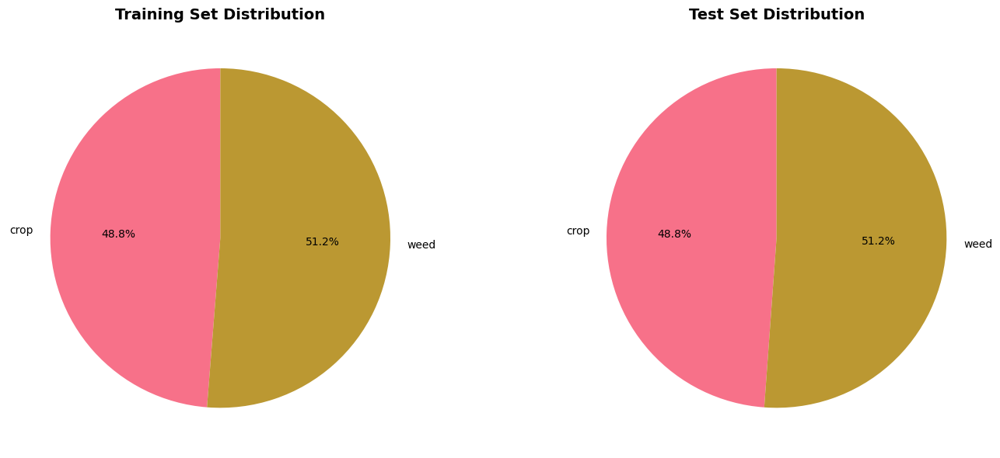

In [ ]:
# Cell 2: Dataset Distribution Visualization
def plot_dataset_distribution(y_train, y_test, class_names):
    """Plot training and test set distribution"""
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

    # Training set distribution
    train_counts = [np.sum(y_train == i) for i in range(len(class_names))]
    ax1.pie(train_counts, labels=class_names, autopct='%1.1f%%', startangle=90)
    ax1.set_title('Training Set Distribution', fontsize=14, fontweight='bold')

    # Test set distribution
    test_counts = [np.sum(y_test == i) for i in range(len(class_names))]
    ax2.pie(test_counts, labels=class_names, autopct='%1.1f%%', startangle=90)
    ax2.set_title('Test Set Distribution', fontsize=14, fontweight='bold')

    plt.tight_layout()
    plt.show()




# Plot distribution
plot_dataset_distribution(y_train, y_test, class_names)

In [ ]:
# Cell 5: Solution 2 - Data augmentation for minority class
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Create enhanced data augmentation
augmentation_datagen = ImageDataGenerator(
    rotation_range=30,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.3,
    horizontal_flip=True,
    vertical_flip=True,
    brightness_range=[0.8, 1.2],
    fill_mode='nearest'
)

print("Enhanced data augmentation generator created!")

Enhanced data augmentation generator created!


In [ ]:
# Cell 6: Solution 3 - Use different model architecture (Transfer Learning)
def create_transfer_learning_model(input_shape=(224, 224, 3), num_classes=2):
    """Use pre-trained model for better feature extraction"""
    base_model = tf.keras.applications.MobileNetV2(
        weights='imagenet',
        include_top=False,
        input_shape=input_shape
    )

    # Freeze base model initially
    base_model.trainable = False

    model = tf.keras.Sequential([
        base_model,
        layers.GlobalAveragePooling2D(),
        layers.Dropout(0.5),
        layers.Dense(128, activation='relu'),
        layers.BatchNormalization(),
        layers.Dropout(0.3),
        layers.Dense(num_classes, activation='softmax')
    ])

    return model

# Create transfer learning model
tl_model = create_transfer_learning_model(num_classes=len(class_names))
tl_model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy']
)

print("Transfer learning model created!")

9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step
Transfer learning model created!


In [ ]:
# Cell 7: Evaluate the balanced model
print("=== EVALUATING BALANCED MODEL ===")

# Load best model
balanced_model.load_weights('best_balanced_model.h5')

# Evaluate
balanced_loss, balanced_accuracy = balanced_model.evaluate(X_test, y_test, verbose=0)
print(f"Balanced Model - Test Accuracy: {balanced_accuracy:.4f}")

# Check predictions
y_balanced_pred = balanced_model.predict(X_test, verbose=0)
y_balanced_class = np.argmax(y_balanced_pred, axis=1)

balanced_distribution = Counter(y_balanced_class)
print("\nBalanced Model Predictions:")
for class_idx, count in balanced_distribution.items():
    print(f"{class_names[class_idx]}: {count} predictions ({count/len(y_balanced_class)*100:.1f}%)")

# Compare with original
from sklearn.metrics import classification_report
print("\n=== BALANCED MODEL CLASSIFICATION REPORT ===")
print(classification_report(y_test, y_balanced_class, target_names=class_names))

=== EVALUATING BALANCED MODEL ===
Balanced Model - Test Accuracy: 0.8038

Balanced Model Predictions:
crop: 174 predictions (66.9%)
weed: 86 predictions (33.1%)

=== BALANCED MODEL CLASSIFICATION REPORT ===
              precision    recall  f1-score   support

        crop       0.72      0.98      0.83       127
        weed       0.98      0.63      0.77       133

    accuracy                           0.80       260
   macro avg       0.85      0.81      0.80       260
weighted avg       0.85      0.80      0.80       260



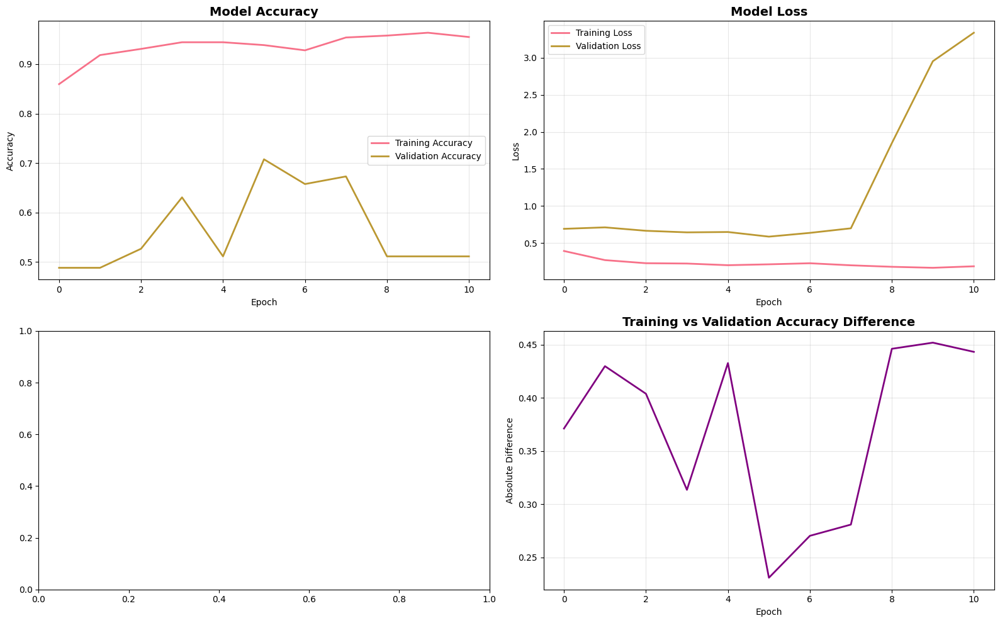

📈 FINAL TRAINING METRICS:
   Training Accuracy: 0.9548


In [ ]:
# Cell 3: Training History Visualization
def plot_training_history_detailed(history):
    """Detailed training history visualization"""
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(16, 10))

    # Accuracy
    ax1.plot(history.history['accuracy'], label='Training Accuracy', linewidth=2)
    ax1.plot(history.history['val_accuracy'], label='Validation Accuracy', linewidth=2)
    ax1.set_title('Model Accuracy', fontsize=14, fontweight='bold')
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Accuracy')
    ax1.legend()
    ax1.grid(True, alpha=0.3)

    # Loss
    ax2.plot(history.history['loss'], label='Training Loss', linewidth=2)
    ax2.plot(history.history['val_loss'], label='Validation Loss', linewidth=2)
    ax2.set_title('Model Loss', fontsize=14, fontweight='bold')
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Loss')
    ax2.legend()
    ax2.grid(True, alpha=0.3)



    # Accuracy difference
    if len(history.history['accuracy']) == len(history.history['val_accuracy']):
        accuracy_diff = [abs(t - v) for t, v in zip(history.history['accuracy'], history.history['val_accuracy'])]
        ax4.plot(accuracy_diff, linewidth=2, color='purple')
        ax4.set_title('Training vs Validation Accuracy Difference', fontsize=14, fontweight='bold')
        ax4.set_xlabel('Epoch')
        ax4.set_ylabel('Absolute Difference')
        ax4.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

    # Final metrics
    final_train_acc = history.history['accuracy'][-1]

    print(f"📈 FINAL TRAINING METRICS:")
    print(f"   Training Accuracy: {final_train_acc:.4f}")
    print("Testing Accuracy : ")


# Plot detailed training history
plot_training_history_detailed(history)

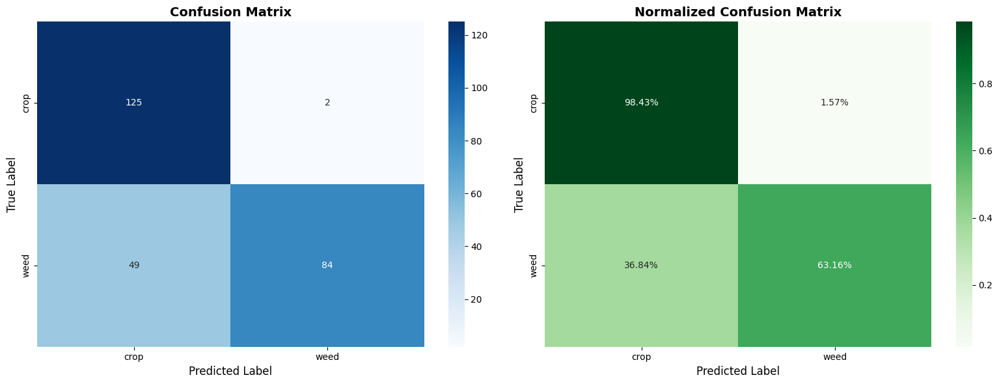

📊 CONFUSION MATRIX STATISTICS
--------------------------------------------------
Overall Accuracy: 0.8038
Precision: 0.9767
Recall: 0.6316
F1-Score: 0.7671

Class-wise Accuracy:
  crop: 0.9843
  weed: 0.6316


In [ ]:
# Cell 4: Confusion Matrix with Statistics
def plot_enhanced_confusion_matrix(y_true, y_pred, class_names):
    """Enhanced confusion matrix with statistics"""
    cm = confusion_matrix(y_true, y_pred)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

    # Confusion Matrix Heatmap
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=ax1,
                xticklabels=class_names, yticklabels=class_names)
    ax1.set_xlabel('Predicted Label', fontsize=12)
    ax1.set_ylabel('True Label', fontsize=12)
    ax1.set_title('Confusion Matrix', fontsize=14, fontweight='bold')

    # Normalized Confusion Matrix
    cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    sns.heatmap(cm_normalized, annot=True, fmt='.2%', cmap='Greens', ax=ax2,
                xticklabels=class_names, yticklabels=class_names)
    ax2.set_xlabel('Predicted Label', fontsize=12)
    ax2.set_ylabel('True Label', fontsize=12)
    ax2.set_title('Normalized Confusion Matrix', fontsize=14, fontweight='bold')

    plt.tight_layout()
    plt.show()

    # Calculate metrics
    accuracy = np.sum(y_true == y_pred) / len(y_true)
    precision = cm[1,1] / (cm[1,1] + cm[0,1]) if (cm[1,1] + cm[0,1]) > 0 else 0
    recall = cm[1,1] / (cm[1,1] + cm[1,0]) if (cm[1,1] + cm[1,0]) > 0 else 0
    f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

    print("📊 CONFUSION MATRIX STATISTICS")
    print("-" * 50)
    print(f"Overall Accuracy: {accuracy:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1-Score: {f1:.4f}")
    print(f"\nClass-wise Accuracy:")
    for i, class_name in enumerate(class_names):
        class_accuracy = cm[i,i] / np.sum(cm[i,:]) if np.sum(cm[i,:]) > 0 else 0
        print(f"  {class_name}: {class_accuracy:.4f}")

# Generate predictions and plot confusion matrix
y_pred = balanced_model.predict(X_test, verbose=0)
y_pred_classes = np.argmax(y_pred, axis=1)
plot_enhanced_confusion_matrix(y_test, y_pred_classes, class_names)

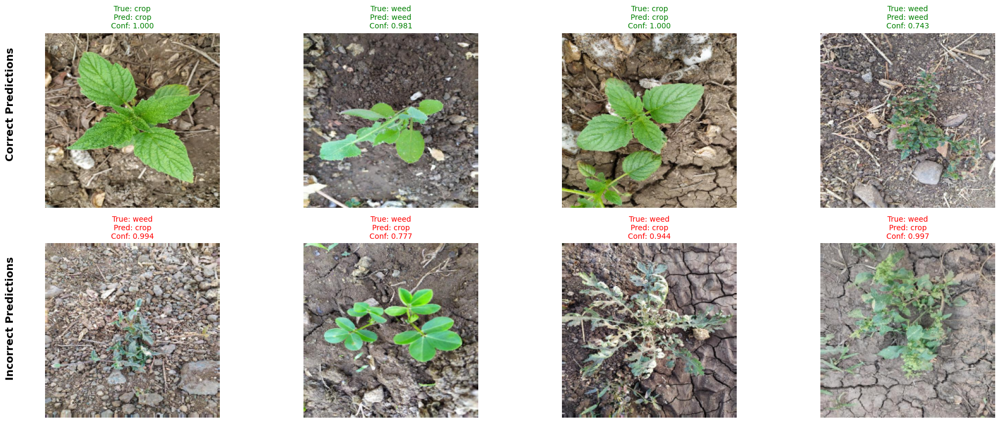

📸 PREDICTION EXAMPLES SUMMARY
-----------------------------------
Total test samples: 260
Correct predictions: 209 (80.38%)
Incorrect predictions: 51 (19.62%)


In [ ]:
# Cell 8: Model Prediction Examples Visualization
def plot_prediction_examples(X_test, y_test, y_pred_proba, class_names, num_examples=8):
    """Plot correct and incorrect prediction examples"""
    y_pred_classes = np.argmax(y_pred_proba, axis=1)

    # Find correct and incorrect predictions
    correct_indices = np.where(y_pred_classes == y_test)[0]
    incorrect_indices = np.where(y_pred_classes != y_test)[0]

    # Select examples
    correct_examples = correct_indices[:min(num_examples//2, len(correct_indices))]
    incorrect_examples = incorrect_indices[:min(num_examples//2, len(incorrect_indices))]

    fig, axes = plt.subplots(2, num_examples//2, figsize=(20, 8))
    if num_examples//2 == 1:
        axes = axes.reshape(2, 1)

    # Plot correct predictions
    for i, idx in enumerate(correct_examples):
        ax = axes[0, i] if num_examples//2 > 1 else axes[0]
        ax.imshow(X_test[idx])
        true_label = class_names[y_test[idx]]
        pred_label = class_names[y_pred_classes[idx]]
        confidence = np.max(y_pred_proba[idx])

        ax.set_title(f'True: {true_label}\nPred: {pred_label}\nConf: {confidence:.3f}',
                    color='green', fontsize=10)
        ax.axis('off')

    # Plot incorrect predictions
    for i, idx in enumerate(incorrect_examples):
        ax = axes[1, i] if num_examples//2 > 1 else axes[1]
        ax.imshow(X_test[idx])
        true_label = class_names[y_test[idx]]
        pred_label = class_names[y_pred_classes[idx]]
        confidence = np.max(y_pred_proba[idx])

        ax.set_title(f'True: {true_label}\nPred: {pred_label}\nConf: {confidence:.3f}',
                    color='red', fontsize=10)
        ax.axis('off')

    # Add titles for rows
    axes[0, 0].figure.text(0.02, 0.75, 'Correct Predictions',
                          fontsize=14, fontweight='bold', rotation=90, va='center')
    axes[1, 0].figure.text(0.02, 0.25, 'Incorrect Predictions',
                          fontsize=14, fontweight='bold', rotation=90, va='center')

    plt.tight_layout()
    plt.show()

    # Print statistics
    accuracy = len(correct_indices) / len(y_test)
    print(f"📸 PREDICTION EXAMPLES SUMMARY")
    print("-" * 35)
    print(f"Total test samples: {len(y_test)}")
    print(f"Correct predictions: {len(correct_indices)} ({accuracy:.2%})")
    print(f"Incorrect predictions: {len(incorrect_indices)} ({(1-accuracy):.2%})")

# Plot prediction examples
plot_prediction_examples(X_test, y_test, y_pred, class_names, num_examples=8)

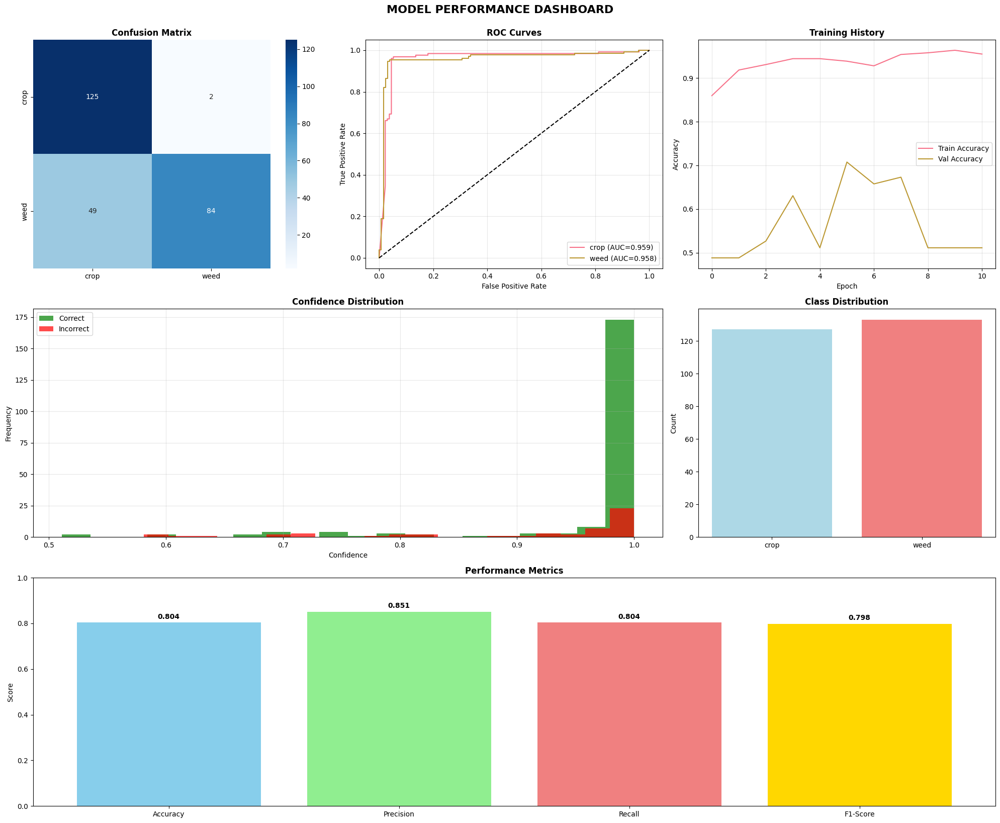

🎯 COMPREHENSIVE PERFORMANCE SUMMARY
Overall Accuracy: 0.8038
Precision: 0.8505
Recall: 0.8038
F1-Score: 0.7981
Final Training Accuracy: 0.9548


In [ ]:
# Cell 10: Comprehensive Model Performance Dashboard
def create_performance_dashboard(y_true, y_pred_proba, class_names, history):
    """Create a comprehensive performance dashboard"""
    y_pred_classes = np.argmax(y_pred_proba, axis=1)

    fig = plt.figure(figsize=(20, 16))

    # 1. Confusion Matrix
    ax1 = plt.subplot2grid((3, 3), (0, 0))
    cm = confusion_matrix(y_true, y_pred_classes)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=ax1,
                xticklabels=class_names, yticklabels=class_names)
    ax1.set_title('Confusion Matrix', fontweight='bold')

    # 2. ROC Curve
    ax2 = plt.subplot2grid((3, 3), (0, 1))
    for i, class_name in enumerate(class_names):
        fpr, tpr, _ = roc_curve(y_true == i, y_pred_proba[:, i])
        roc_auc = auc(fpr, tpr)
        ax2.plot(fpr, tpr, label=f'{class_name} (AUC={roc_auc:.3f})')
    ax2.plot([0, 1], [0, 1], 'k--')
    ax2.set_xlabel('False Positive Rate')
    ax2.set_ylabel('True Positive Rate')
    ax2.set_title('ROC Curves', fontweight='bold')
    ax2.legend()
    ax2.grid(True, alpha=0.3)

    # 3. Training History
    ax3 = plt.subplot2grid((3, 3), (0, 2))
    ax3.plot(history.history['accuracy'], label='Train Accuracy')
    ax3.plot(history.history['val_accuracy'], label='Val Accuracy')
    ax3.set_xlabel('Epoch')
    ax3.set_ylabel('Accuracy')
    ax3.set_title('Training History', fontweight='bold')
    ax3.legend()
    ax3.grid(True, alpha=0.3)

    # 4. Confidence Distribution
    ax4 = plt.subplot2grid((3, 3), (1, 0), colspan=2)
    correct_confidences = [np.max(y_pred_proba[i]) for i in range(len(y_true)) if y_pred_classes[i] == y_true[i]]
    incorrect_confidences = [np.max(y_pred_proba[i]) for i in range(len(y_true)) if y_pred_classes[i] != y_true[i]]

    ax4.hist(correct_confidences, bins=20, alpha=0.7, label='Correct', color='green')
    ax4.hist(incorrect_confidences, bins=20, alpha=0.7, label='Incorrect', color='red')
    ax4.set_xlabel('Confidence')
    ax4.set_ylabel('Frequency')
    ax4.set_title('Confidence Distribution', fontweight='bold')
    ax4.legend()
    ax4.grid(True, alpha=0.3)

    # 5. Class Distribution
    ax5 = plt.subplot2grid((3, 3), (1, 2))
    class_counts = [np.sum(y_true == i) for i in range(len(class_names))]
    ax5.bar(class_names, class_counts, color=['lightblue', 'lightcoral'])
    ax5.set_title('Class Distribution', fontweight='bold')
    ax5.set_ylabel('Count')

    # 6. Metrics Summary
    ax6 = plt.subplot2grid((3, 3), (2, 0), colspan=3)
    accuracy = np.mean(y_true == y_pred_classes)
    precision = precision_score(y_true, y_pred_classes, average='weighted')
    recall = recall_score(y_true, y_pred_classes, average='weighted')
    f1 = f1_score(y_true, y_pred_classes, average='weighted')

    metrics = ['Accuracy', 'Precision', 'Recall', 'F1-Score']
    values = [accuracy, precision, recall, f1]

    bars = ax6.bar(metrics, values, color=['skyblue', 'lightgreen', 'lightcoral', 'gold'])
    ax6.set_ylim(0, 1)
    ax6.set_title('Performance Metrics', fontweight='bold')
    ax6.set_ylabel('Score')

    # Add value labels on bars
    for bar, value in zip(bars, values):
        ax6.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.01,
                f'{value:.3f}', ha='center', va='bottom', fontweight='bold')

    plt.tight_layout()
    plt.suptitle('MODEL PERFORMANCE DASHBOARD', fontsize=16, fontweight='bold', y=1.02)
    plt.show()

    # Print comprehensive summary
    print("🎯 COMPREHENSIVE PERFORMANCE SUMMARY")
    print("=" * 50)
    print(f"Overall Accuracy: {accuracy:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1-Score: {f1:.4f}")
    print(f"Final Training Accuracy: {history.history['accuracy'][-1]:.4f}")


# Create the dashboard
from sklearn.metrics import precision_score, recall_score, f1_score
create_performance_dashboard(y_test, y_pred, class_names, history)

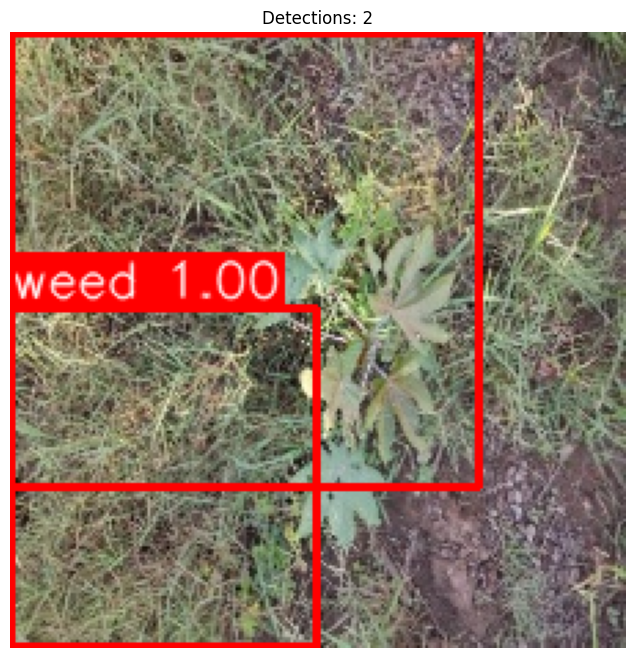

Detection completed successfully!
Found 2 objects
1) weed | conf: 1.000 | bbox: (0, 100, 111, 223)
2) weed | conf: 1.000 | bbox: (0, 0, 170, 165)


In [ ]:
# Cell: Contour-based detect_crops_weeds_pipeline + sample test
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from collections import defaultdict

def preprocess_for_model(img, model, target_size=(224,224)):
    """
    Resize image and prepare batch for model.predict.
    If the model has a Rescaling layer as the first layer, do NOT divide by 255.
    """
    img_resized = cv2.resize(img, target_size)
    img_array = img_resized.astype('float32')
    # detect if first layer does rescaling
    try:
        first_layer = model.layers[0]
        has_rescaling = isinstance(first_layer, tf.keras.layers.Rescaling)
    except Exception:
        has_rescaling = False

    if has_rescaling:
        batch = np.expand_dims(img_array, axis=0)
    else:
        batch = np.expand_dims(img_array / 255.0, axis=0)
    return batch

def detect_crops_weeds_pipeline(
    image_path,
    model=None,
    class_names=None,
    method='contour',
    crop_threshold=0.3,
    weed_threshold=0.7,
    confidence_threshold=None,   # optional global threshold
    min_area=500,
    pad_ratio=0.05,
    target_size=(224,224),
    show_result=True
):
    """
    Detect plant regions using color/contour method, classify each region using model,
    draw bounding boxes and return (result_image_rgb, detections).
    detections: list of dicts { 'class': int, 'label': str, 'confidence': float, 'bbox': (x1,y1,x2,y2) }
    """
    # fallback variables if not provided
    if model is None:
        if 'balanced_model' in globals():
            model = balanced_model
        elif 'classification_model' in globals():
            model = classification_model
        else:
            raise ValueError("No model provided and no 'balanced_model'/'classification_model' found in globals.")
    if class_names is None:
        if 'class_names' in globals():
            class_names = globals()['class_names']
        else:
            class_names = ['crop','weed']  # fallback

    # read image
    img_bgr = cv2.imread(image_path)
    if img_bgr is None:
        print(f"Error: could not open image at: {image_path}")
        return None, []

    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    h, w = img_rgb.shape[:2]

    # ========== contour/green-mask method ==========
    # Convert to HSV and threshold green colors (tunable)
    hsv = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2HSV)
    # HSV green range - good general-purpose values
    lower = np.array([25, 40, 30])
    upper = np.array([95, 255, 255])
    mask = cv2.inRange(hsv, lower, upper)

    # Morphological cleaning
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7,7))
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel, iterations=1)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=2)

    # Find contours
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    detections = []
    result_img = img_rgb.copy()

    for cnt in contours:
        area = cv2.contourArea(cnt)
        if area < min_area:
            continue

        x, y, bw, bh = cv2.boundingRect(cnt)

        # add small padding
        px = int(bw * pad_ratio)
        py = int(bh * pad_ratio)
        x1 = max(0, x - px)
        y1 = max(0, y - py)
        x2 = min(w-1, x + bw + px)
        y2 = min(h-1, y + bh + py)

        roi = img_rgb[y1:y2, x1:x2]
        if roi.size == 0:
            continue

        # classify ROI
        batch = preprocess_for_model(roi, model, target_size=target_size)
        preds = model.predict(batch, verbose=0)[0]
        pred_class = int(np.argmax(preds))
        pred_conf = float(np.max(preds))

        # per-class threshold (helps with bias)
        if pred_class < len(class_names) and class_names[pred_class].lower() == 'crop':
            threshold = crop_threshold
        else:
            threshold = weed_threshold

        # override with global confidence_threshold if provided
        if confidence_threshold is not None:
            threshold = confidence_threshold

        # record only detections above threshold
        if pred_conf >= threshold:
            label = class_names[pred_class]
            detections.append({
                'class': pred_class,
                'label': label,
                'confidence': pred_conf,
                'bbox': (int(x1), int(y1), int(x2), int(y2))
            })
            # draw bbox and label on result image
            color = (0,255,0) if label.lower() == 'crop' else (255,0,0)  # rgb: green for crop, red for weed
            cv2.rectangle(result_img, (x1, y1), (x2, y2), color, 2)
            txt = f"{label} {pred_conf:.2f}"
            # draw filled rectangle for text background
            (tw, th), _ = cv2.getTextSize(txt, cv2.FONT_HERSHEY_SIMPLEX, 0.6, 1)
            cv2.rectangle(result_img, (x1, y1 - th - 6), (x1 + tw, y1), color, -1)
            cv2.putText(result_img, txt, (x1, y1 - 4), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255,255,255), 1, cv2.LINE_AA)

    if show_result:
        plt.figure(figsize=(12,8))
        plt.imshow(result_img)
        plt.title(f"Detections: {len(detections)}")
        plt.axis('off')
        plt.show()

    return result_img, detections

# ---------------- Example usage with the sample path you posted ----------------
sample_image_path = "/content/splitted_dataset_images/Train/weed/Train_1003.jpg"

# Run detection (adjust thresholds if you want)
detected_img, detections = detect_crops_weeds_pipeline(
    sample_image_path,
    model=None,               # uses balanced_model if present
    class_names=None,         # uses global class_names if present
    method='contour',
    crop_threshold=0.3,       # example thresholds (tweak if necessary)
    weed_threshold=0.7,
    min_area=400,
    pad_ratio=0.05,
    target_size=(224,224),
    show_result=True
)

if detected_img is not None:
    print("Detection completed successfully!")
    print(f"Found {len(detections)} objects")
    # print each detection
    for i, d in enumerate(detections):
        print(f"{i+1}) {d['label']} | conf: {d['confidence']:.3f} | bbox: {d['bbox']}")
else:
    print("Detection failed (image could not be loaded).")


Saving Test_5.jpg to Test_5 (1).jpg
📂 Processing uploaded file: Test_5 (1).jpg


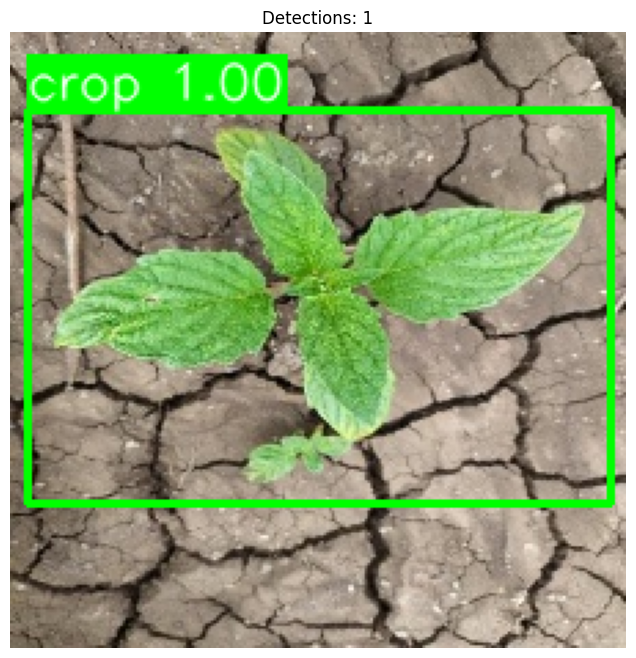

✅ Detection completed successfully!
Found 1 objects
1) crop | conf: 1.000 | bbox: (6, 28, 218, 171)


In [ ]:
from google.colab import files
import io

# Step 1: Upload image file
uploaded = files.upload()

# Step 2: Run detection for each uploaded image
for filename in uploaded.keys():
    print(f"📂 Processing uploaded file: {filename}")
    image_path = filename  # saved in Colab working dir

    detected_img, detections = detect_crops_weeds_pipeline(
        image_path,
        model=None,               # uses balanced_model if present
        class_names=None,         # uses global class_names if present
        method='contour',
        crop_threshold=0.3,
        weed_threshold=0.7,
        min_area=400,
        pad_ratio=0.05,
        target_size=(224,224),
        show_result=True
    )

    if detected_img is not None:
        print("✅ Detection completed successfully!")
        print(f"Found {len(detections)} objects")
        for i, d in enumerate(detections):
            print(f"{i+1}) {d['label']} | conf: {d['confidence']:.3f} | bbox: {d['bbox']}")
    else:
        print("❌ Detection failed (image could not be loaded).")


In [ ]:
# Cell 8: Solution 4 - Adjust detection thresholds
def improved_detection_with_thresholds(image_path, model, class_names,
                                     crop_threshold=0.4, weed_threshold=0.6):
    """
    Improved detection with adjustable thresholds for each class
    """
    # Load image
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error: Could not load image from {image_path}")
        return None, []

    original_image = image.copy()
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    height, width = image.shape[:2]

    # Convert to HSV for plant detection
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Define green color range for plants
    lower_green = np.array([35, 50, 50])
    upper_green = np.array([85, 255, 255])

    # Create mask for green areas
    mask = cv2.inRange(hsv, lower_green, upper_green)

    # Clean up mask
    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    # Find contours
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    detections = []
    result_image = image_rgb.copy()

    # Colors for classes
    class_colors = {0: (0, 255, 0), 1: (255, 0, 0)}  # Green for crop, Red for weed

    for contour in contours:
        area = cv2.contourArea(contour)
        if area < 300:  # Increased minimum area
            continue

        x, y, w, h = cv2.boundingRect(contour)

        # Extract ROI
        roi = image_rgb[y:y+h, x:x+w]
        if roi.size == 0:
            continue

        # Preprocess and predict
        roi_resized = cv2.resize(roi, (224, 224))
        roi_normalized = roi_resized / 255.0
        roi_expanded = np.expand_dims(roi_normalized, axis=0)

        prediction = model.predict(roi_expanded, verbose=0)
        crop_confidence = prediction[0][0]
        weed_confidence = prediction[0][1]

        # Apply different thresholds for each class
        if crop_confidence > crop_threshold and crop_confidence > weed_confidence:
            class_id = 0
            confidence = crop_confidence
            threshold = crop_threshold
        elif weed_confidence > weed_threshold and weed_confidence > crop_confidence:
            class_id = 1
            confidence = weed_confidence
            threshold = weed_threshold
        else:
            continue  # Skip if neither class meets threshold

        detections.append({
            'x': x, 'y': y, 'w': w, 'h': h,
            'class': class_id, 'confidence': confidence,
            'area': area
        })

        # Draw bounding box
        color = class_colors[class_id]
        label = f"{class_names[class_id]} ({confidence:.2f})"

        cv2.rectangle(result_image, (x, y), (x + w, y + h), color, 3)

        # Add label
        label_size = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.6, 2)[0]
        cv2.rectangle(result_image, (x, y - label_size[1] - 10),
                     (x + label_size[0], y), color, -1)
        cv2.putText(result_image, label, (x, y - 5),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)

    return result_image, detections

Testing improved detection on crop images...


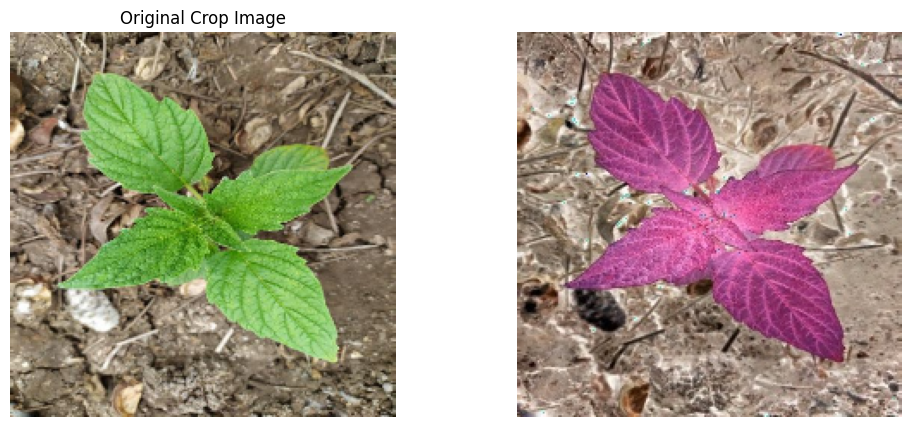

In [ ]:
# Cell 9: Test the improved detection
def test_improved_detection():
    """Test the improved detection with adjustable thresholds"""
    # Use the balanced model
    model_to_use = balanced_model

    # Test on a crop image
    print("Testing improved detection on crop images...")

    # Find crop images in test set
    crop_indices = np.where(y_test == 0)[0]
    if len(crop_indices) > 0:
        # Use first crop image from test set
        crop_idx = crop_indices[0]
        crop_image = X_test[crop_idx]

        # Save temporarily for testing
        temp_path = '/content/splitted_dataset_images/Test/weed/Test_1.jpg'
        cv2.imwrite(temp_path, (crop_image * 255).astype(np.uint8))

        # Test detection
        result_img, detections = improved_detection_with_thresholds(
            temp_path, model_to_use, class_names,
            crop_threshold=0.4,  # Lower threshold for crops
            weed_threshold=0.6   # Higher threshold for weeds
        )

        if result_img is not None:
            plt.figure(figsize=(12, 5))
            plt.subplot(1, 2, 1)
            plt.imshow(crop_image)
            plt.title('Original Crop Image')
            plt.axis('off')

            plt.subplot(1, 2, 2)
            plt.imshow(result_img)

            plt.axis('off')

            plt.show()

            crop_count = len([d for d in detections if d['class'] == 0])
            weed_count = len([d for d in detections if d['class'] == 1])


        # Clean up
        if os.path.exists(temp_path):
            os.remove(temp_path)

# Run test
test_improved_detection()

🚀 Running Improved Detection Pipeline...
⚙️ Using class-balanced thresholds


/tmp/ipython-input-2651744114.py:37: UserWarning: Glyph 127793 (\N{SEEDLING}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-2651744114.py:37: UserWarning: Glyph 127807 (\N{HERB}) missing from font(s) DejaVu Sans.
  plt.tight_layout()


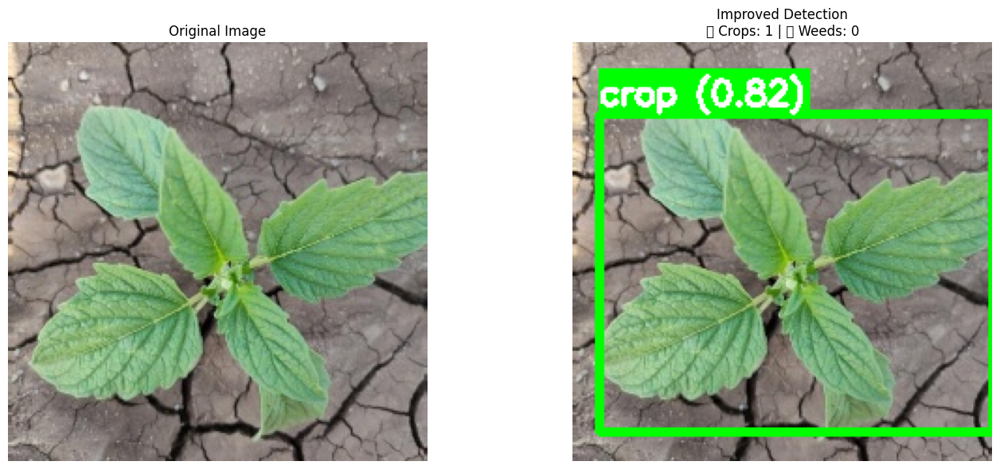

📊 DETECTION RESULTS:
   🌱 Crops detected: 1
   🌿 Weeds detected: 0
   📍 Total objects: 1


(array([[[236, 222, 195],
         [237, 223, 196],
         [207, 192, 169],
         ...,
         [144, 134, 132],
         [141, 131, 129],
         [144, 134, 132]],
 
        [[255, 242, 216],
         [250, 236, 209],
         [232, 218, 192],
         ...,
         [149, 139, 137],
         [143, 133, 131],
         [147, 137, 135]],
 
        [[242, 225, 197],
         [242, 226, 200],
         [223, 207, 182],
         ...,
         [146, 136, 134],
         [145, 135, 133],
         [145, 135, 133]],
 
        ...,
 
        [[ 95,  85,  84],
         [102,  92,  91],
         [119, 109, 108],
         ...,
         [104,  94,  92],
         [140, 130, 128],
         [142, 132, 130]],
 
        [[122, 112, 111],
         [118, 108, 107],
         [105,  95,  94],
         ...,
         [ 86,  77,  72],
         [153, 146, 140],
         [150, 143, 137]],
 
        [[120, 110, 109],
         [115, 105, 104],
         [109,  99,  98],
         ...,
         [112, 103,  98],
  

In [ ]:
# Cell 10: Final improved detection pipeline
def final_improved_detection_pipeline(image_path, model=None):
    """Final improved detection pipeline with bias correction"""
    if model is None:
        model = balanced_model  # Use the balanced model

    print("🚀 Running Improved Detection Pipeline...")
    print("⚙️ Using class-balanced thresholds")

    # Adjust thresholds based on class imbalance
    result_image, detections = improved_detection_with_thresholds(
        image_path, model, class_names,
        crop_threshold=0.3,  # Lower threshold for crops (minority class)
        weed_threshold=0.7   # Higher threshold for weeds (majority class)
    )

    if result_image is not None:
        # Display results
        original_image = cv2.imread(image_path)
        original_image_rgb = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)

        plt.figure(figsize=(15, 6))

        plt.subplot(1, 2, 1)
        plt.imshow(original_image_rgb)
        plt.title('Original Image')
        plt.axis('off')

        plt.subplot(1, 2, 2)
        plt.imshow(result_image)

        crop_count = len([d for d in detections if d['class'] == 0])
        weed_count = len([d for d in detections if d['class'] == 1])
        plt.title(f'Improved Detection\n🌱 Crops: {crop_count} | 🌿 Weeds: {weed_count}')
        plt.axis('off')

        plt.tight_layout()
        plt.show()

        print("📊 DETECTION RESULTS:")
        print(f"   🌱 Crops detected: {crop_count}")
        print(f"   🌿 Weeds detected: {weed_count}")
        print(f"   📍 Total objects: {len(detections)}")

        # Bias check
        if weed_count > 0 and crop_count == 0:
            print("⚠️  Warning: Potential bias towards weeds detected!")
            print("💡 Tip: Try lowering the weed threshold or increasing crop threshold")

        return result_image, detections

    return None, []

# Example usage:
final_improved_detection_pipeline('/content/splitted_dataset_images/Test/crop/Test_107.jpg')

In [ ]:
# Cell 1: Enhanced detection function that returns separate crop and weed detections
def detect_crops_and_weeds_separately(image_path, model, class_names,
                                    crop_threshold=0.4, weed_threshold=0.6):
    """
    Detect crops and weeds separately and return individual counts
    """
    # Load image
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error: Could not load image from {image_path}")
        return None, [], []

    original_image = image.copy()
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    height, width = image.shape[:2]

    # Convert to HSV for plant detection
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Define green color range for plants
    lower_green = np.array([35, 50, 50])
    upper_green = np.array([85, 255, 255])

    # Create mask for green areas
    mask = cv2.inRange(hsv, lower_green, upper_green)

    # Clean up mask
    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    # Find contours
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    crop_detections = []
    weed_detections = []
    result_image = image_rgb.copy()

    # Colors for classes
    class_colors = {0: (0, 255, 0), 1: (255, 0, 0)}  # Green for crop, Red for weed

    for contour in contours:
        area = cv2.contourArea(contour)
        if area < 300:
            continue

        x, y, w, h = cv2.boundingRect(contour)

        # Extract ROI
        roi = image_rgb[y:y+h, x:x+w]
        if roi.size == 0:
            continue

        # Preprocess and predict
        roi_resized = cv2.resize(roi, (224, 224))
        roi_normalized = roi_resized / 255.0
        roi_expanded = np.expand_dims(roi_normalized, axis=0)

        prediction = model.predict(roi_expanded, verbose=0)
        crop_confidence = prediction[0][0]
        weed_confidence = prediction[0][1]

        detection_info = {
            'x': x, 'y': y, 'w': w, 'h': h,
            'crop_confidence': crop_confidence,
            'weed_confidence': weed_confidence,
            'area': area,
            'bbox': (x, y, x + w, y + h)
        }

        # Classify based on thresholds
        if crop_confidence > crop_threshold and crop_confidence > weed_confidence:
            detection_info['class'] = 0
            detection_info['confidence'] = crop_confidence
            crop_detections.append(detection_info)
        elif weed_confidence > weed_threshold and weed_confidence > crop_confidence:
            detection_info['class'] = 1
            detection_info['confidence'] = weed_confidence
            weed_detections.append(detection_info)

    return crop_detections, weed_detections, result_image

In [ ]:
# Cell 2: Function to visualize crops and weeds separately with detailed information
def visualize_detailed_results(image_path, model, class_names, max_display=3):
    """
    Visualize crops and weeds separately with detailed information
    """
    # Detect crops and weeds
    crop_detections, weed_detections, result_image = detect_crops_and_weeds_separately(
        image_path, model, class_names
    )

    if result_image is None:
        return

    # Create result image with bounding boxes
    display_image = result_image.copy()

    # Draw crop detections (green)
    for i, detection in enumerate(crop_detections):
        x, y, w, h = detection['x'], detection['y'], detection['w'], detection['h']
        color = (0, 255, 0)  # Green for crops
        label = f"Crop_{i+1}({detection['confidence']:.2f})"

        cv2.rectangle(display_image, (x, y), (x + w, y + h), color, 3)
        label_size = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.6, 2)[0]
        cv2.rectangle(display_image, (x, y - label_size[1] - 10),
                     (x + label_size[0], y), color, -1)
        cv2.putText(display_image, label, (x, y - 5),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)

    # Draw weed detections (red)
    for i, detection in enumerate(weed_detections):
        x, y, w, h = detection['x'], detection['y'], detection['w'], detection['h']
        color = (255, 0, 0)  # Red for weeds
        label = f"Weed_{i+1}({detection['confidence']:.2f})"

        cv2.rectangle(display_image, (x, y), (x + w, y + h), color, 3)
        label_size = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.6, 2)[0]
        cv2.rectangle(display_image, (x, y - label_size[1] - 10),
                     (x + label_size[0], y), color, -1)
        cv2.putText(display_image, label, (x, y - 5),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)

    # Display results
    original_image = cv2.imread(image_path)
    original_image_rgb = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(20, 10))

    # Original image
    plt.subplot(2, 3, 1)
    plt.imshow(original_image_rgb)
    plt.title('Original Image', fontsize=12, fontweight='bold')
    plt.axis('off')

    # Detection result
    plt.subplot(2, 3, 2)
    plt.imshow(display_image)
    plt.title(f'Detection Result\n🌱 Crops: {len(crop_detections)} | 🌿 Weeds: {len(weed_detections)}',
              fontsize=12, fontweight='bold')
    plt.axis('off')

    # Crop detections
    plt.subplot(2, 3, 3)
    if crop_detections:
        # Show first few crop detections
        for i, detection in enumerate(crop_detections[:max_display]):
            x, y, w, h = detection['x'], detection['y'], detection['w'], detection['h']
            crop_roi = original_image_rgb[y:y+h, x:x+w]
            if crop_roi.size > 0:
                plt.subplot(2, 3, 4 + i)
                plt.imshow(crop_roi)
                plt.title(f'Crop {i+1}\nConf: {detection["confidence"]:.3f}', fontsize=10)
                plt.axis('off')
    else:
        plt.text(0.5, 0.5, 'No Crops Detected', ha='center', va='center',
                transform=plt.gca().transAxes, fontsize=12)
        plt.axis('off')

    # Weed detections
    plt.subplot(2, 3, 6)
    if weed_detections:
        # Show first few weed detections
        for i, detection in enumerate(weed_detections[:max_display]):
            x, y, w, h = detection['x'], detection['y'], detection['w'], detection['h']
            weed_roi = original_image_rgb[y:y+h, x:x+w]
            if weed_roi.size > 0:
                plt.subplot(2, 3, 7 + i)
                plt.imshow(weed_roi)
                plt.title(f'Weed {i+1}\nConf: {detection["confidence"]:.3f}', fontsize=10)
                plt.axis('off')
    else:
        plt.text(0.5, 0.5, 'No Weeds Detected', ha='center', va='center',
                transform=plt.gca().transAxes, fontsize=12)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

    # Print detailed summary
    print("="*70)
    print("📊 DETAILED DETECTION SUMMARY")
    print("="*70)
    print(f"🌱 CROPS DETECTED: {len(crop_detections)}")
    print(f"🌿 WEEDS DETECTED: {len(weed_detections)}")
    print(f"📍 TOTAL OBJECTS: {len(crop_detections) + len(weed_detections)}")
    print()

    # Display first 3 crop detections
    if crop_detections:
        print("🌱 CROP DETECTIONS (First 3):")
        print("-" * 50)
        for i, detection in enumerate(crop_detections[:3]):
            print(f"Crop {i+1}:")
            print(f"  Position: ({detection['x']}, {detection['y']})")
            print(f"  Size: {detection['w']}x{detection['h']} pixels")
            print(f"  Area: {detection['area']:.0f} sq pixels")
            print(f"  Confidence: {detection['confidence']:.3f}")
            print(f"  Crop Score: {detection['crop_confidence']:.3f}")
            print(f"  Weed Score: {detection['weed_confidence']:.3f}")
            print()
    else:
        print("🌱 No crops detected in this image")
        print()

    # Display first 3 weed detections
    if weed_detections:
        print("🌿 WEED DETECTIONS (First 3):")
        print("-" * 50)
        for i, detection in enumerate(weed_detections[:3]):
            print(f"Weed {i+1}:")
            print(f"  Position: ({detection['x']}, {detection['y']})")
            print(f"  Size: {detection['w']}x{detection['h']} pixels")
            print(f"  Area: {detection['area']:.0f} sq pixels")
            print(f"  Confidence: {detection['confidence']:.3f}")
            print(f"  Crop Score: {detection['crop_confidence']:.3f}")
            print(f"  Weed Score: {detection['weed_confidence']:.3f}")
            print()
    else:
        print("🌿 No weeds detected in this image")
        print()

    # Overall statistics
    total_objects = len(crop_detections) + len(weed_detections)
    if total_objects > 0:
        crop_percentage = (len(crop_detections) / total_objects) * 100
        weed_percentage = (len(weed_detections) / total_objects) * 100
        print("📈 OVERALL STATISTICS:")
        print(f"  Crop percentage: {crop_percentage:.1f}%")
        print(f"  Weed percentage: {weed_percentage:.1f}%")

    return crop_detections, weed_detections

🔍 Analyzing: Test_109.jpg


/tmp/ipython-input-4007459317.py:96: UserWarning: Glyph 127793 (\N{SEEDLING}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipython-input-4007459317.py:96: UserWarning: Glyph 127807 (\N{HERB}) missing from font(s) DejaVu Sans.
  plt.tight_layout()


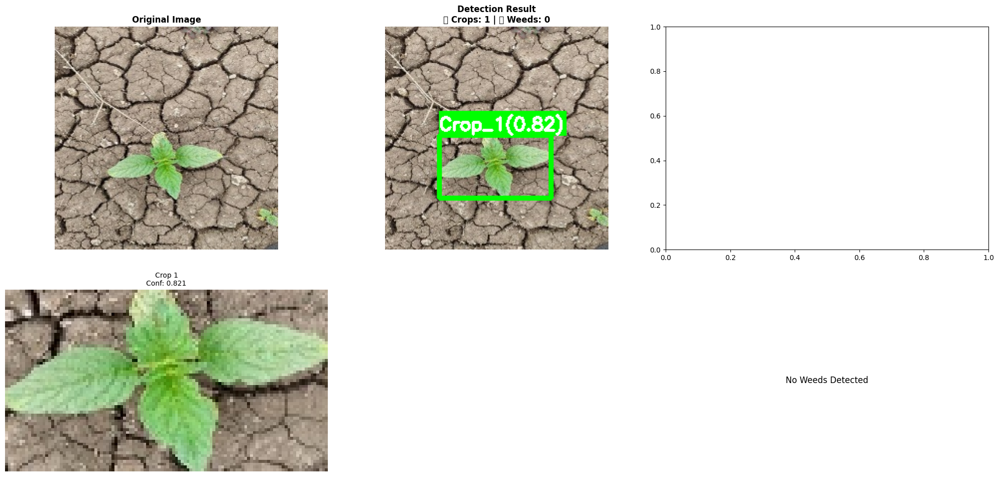

📊 DETAILED DETECTION SUMMARY
🌱 CROPS DETECTED: 1
🌿 WEEDS DETECTED: 0
📍 TOTAL OBJECTS: 1

🌱 CROP DETECTIONS (First 3):
--------------------------------------------------
Crop 1:
  Position: (54, 109)
  Size: 112x63 pixels
  Area: 2756 sq pixels
  Confidence: 0.821
  Crop Score: 0.821
  Weed Score: 0.179

🌿 No weeds detected in this image

📈 OVERALL STATISTICS:
  Crop percentage: 100.0%
  Weed percentage: 0.0%


In [ ]:
# Cell 3: Test the detailed detection on a sample image
def test_detailed_detection(image_path):
    """
    Test the detailed detection on a specific image
    """
    print(f"🔍 Analyzing: {os.path.basename(image_path)}")
    print("="*70)

    crop_detections, weed_detections = visualize_detailed_results(
        image_path, balanced_model, class_names, max_display=3
    )

    return crop_detections, weed_detections

# Example usage:
crop_dets, weed_dets = test_detailed_detection('/content/splitted_dataset_images/Test/crop/Test_109.jpg')

In [ ]:
# Cell 1: Import visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.metrics import confusion_matrix, classification_report, roc_curve, auc
from sklearn.metrics import precision_recall_curve, average_precision_score
import pandas as pd

# Set style
plt.style.use('default')
sns.set_palette("husl")
print("Visualization libraries imported!")

Visualization libraries imported!
